**Общая информация:**

Для инвесторов из фонда «Shut Up and Take My Money» требуется подготовить исследование рынка общественного питания Москвы на основании доступных данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года, изучить разные виды заведений, средний чек и их локации. На основании исследования установить закономерности, особенности и дать рекомендации для дальнейших действий.

**Цель проекта:**
- Проанализировать структуру рынка общественного питания в Москве
- Оценить наиболее перспективные категории заведений
- Оценить возможные локации для открытия нового заведения
- Проанализировать ценовое позиционирование различных категорий 
- Проанализировать перспективы открытия новой кофейни


In [1]:
# Импортируем библиотеки
!pip install missingno
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import plotly.express as px
from plotly import graph_objects as go
import folium
import json
from folium import Map, Marker, Choropleth
from folium.plugins import MarkerCluster
import missingno as msno
from math import *

### Предобработка данных

In [2]:
# Загружаем датасет
places=pd.read_csv('/datasets/moscow_places.csv')
places.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [3]:
# Рассмотрим общую информацию по датасету
places.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


*Названия столбцов и тип данных корректные, в ряде столбцов есть пропуски, рассмотрим их количество и долю*

#### Обработка пропусков

In [4]:
# Количество пропусков
places.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [5]:
# Доля пропусков
places.isna().mean()

name                 0.000000
category             0.000000
address              0.000000
district             0.000000
hours                0.063764
lat                  0.000000
lng                  0.000000
rating               0.000000
price                0.605639
avg_bill             0.546039
middle_avg_bill      0.625387
middle_coffee_cup    0.936355
chain                0.000000
seats                0.429574
dtype: float64

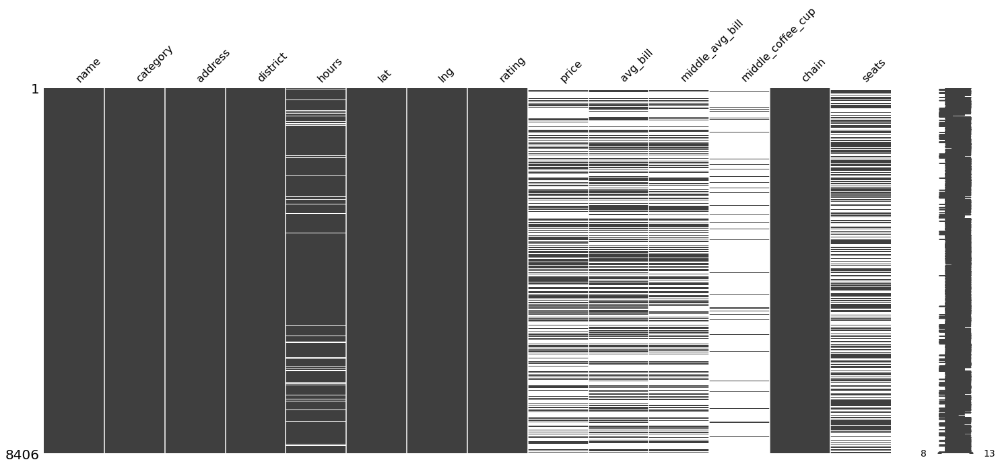

In [6]:
# Рассмотрим взаимосвязь пропусков
msno.matrix(places)
plt.show()

*Из представленных данных видим, что основная доля пропусков приходится на столбцы с ценами, при этом, как видно из матрицы, пропуски в столбцах price, avg_bill, middle_avg_bill в большинстве случаев совпадают. Проверим, не содержат ли столбцы price и avg_bill значения, которые могут быть использованы для заполнения пропусков столбцо вmiddle_avg_bill и  middle_coffe_cup*

In [7]:
# Проверим, нет ли неизвлеченных данных по цене чашки кофе в столбце avg_bill
print(f" Слово капучино встречается \
{places.query('middle_coffee_cup.isna()')['avg_bill'].str.contains('капучино').sum()} раз")

 Слово капучино встречается 0 раз


In [8]:
# Проверим, нет ли неизвлеченных данных для среднего чека в столбце avg_bill
print(f" Слово Средний встречается \
{places.query('middle_avg_bill.isna()')['avg_bill'].str.contains('Средний').sum()} раз")

 Слово Средний встречается 0 раз


*В столбце avg_bill нет неизвлеченных данных, которые можно было бы использовать для заполнения других столбцов с ценами. При этом заполнение столбцов средними значениями считаю некорректным, так как все параметры могут варьироваться в зависимости от расположения заведения, использование усредненных данных может исказить результаты исследования*  

#### Поиск дубликатов

In [9]:
# Проверим наличие явных дубликатов
print('Количество полных дубликатов:', places.duplicated().sum())

Количество полных дубликатов: 0


In [10]:
# Проверим наличие дубликатов по параметрам имя и адрес
print('Количество дубликатов по имени и адресу:',places.duplicated(subset=['name', 'address']).sum())

Количество дубликатов по имени и адресу: 0


In [11]:
# Приведем название кофеен к нижнему регистру для поиска неявных дубликатов
places['name']=places['name'].str.lower()

In [12]:
print('Количество дубликатов по имени и адресу:',places.duplicated(subset=['name', 'address']).sum())

Количество дубликатов по имени и адресу: 3


In [13]:
# Исключим дубликаты
places = places.drop_duplicates(subset=['name', 'address'], keep='first').reset_index(drop=True)

#### Обработка аномальных значений

In [14]:
# Проверим данные в столбце с категориями заведений
places['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

*В категориях данные без дубликатов и ошибок*

In [15]:
# Проверим данные в столбце со средним чеком
places['middle_avg_bill'].describe()

count     3149.000000
mean       958.053668
std       1009.732845
min          0.000000
25%        375.000000
50%        750.000000
75%       1250.000000
max      35000.000000
Name: middle_avg_bill, dtype: float64

*Максимальный средний чек составляет 35000, что во много превышает среднее значение, также присутствуют строки с нулевым значением, . Рассмотрим подробнее заведения с чеком более 10000 и 0*

In [16]:
places.query('middle_avg_bill>10000 or middle_avg_bill==0')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
730,чойхона,"бар,паб","Москва, Дмитровское шоссе, 95А",Северный административный округ,"ежедневно, 10:00–23:00",55.871497,37.543555,4.4,высокие,Средний счёт:5000–17000 ₽,11000.0,NaN,0,49.0
3685,кофемания,кофейня,"Москва, улица Новый Арбат, 19",Центральный административный округ,"ежедневно, круглосуточно",55.752136,37.587784,4.5,высокие,Средний счёт:от 0 ₽,0.0,NaN,1,200.0
7174,кафе,ресторан,"Москва, Каширское шоссе, 23, стр. 2",Южный административный округ,"ежедневно, круглосуточно",55.657450,37.646665,4.1,высокие,Средний счёт:20000–50000 ₽,35000.0,NaN,0,100.0


*Высокий средний счет встречается в двух заведениях, учитывая их категорию, количество посадочных мест и ценовую категорию можно предположить, что цифры реальные. Для кофемании данные некорректные, но так как в дальнейшем исследовании требуется изучение кофеен, не будем исключать это заведение для анализа остальных параметров, а при расчетах будем использовать медианные значения*  

In [17]:
# Проверим данные в столбце с рейтингом заведений
places['rating'].describe()

count    8403.000000
mean        4.229894
std         0.470426
min         1.000000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

*Данные в рейтинге адекватные*

In [18]:
# Проверим данные в столбце с посадочными местами
places['seats'].describe()

count    4792.000000
mean      108.361436
std       122.841130
min         0.000000
25%        40.000000
50%        75.000000
75%       140.000000
max      1288.000000
Name: seats, dtype: float64

*Из данных выше видим, что в таблице есть заведения с аномальным количеством посадочных мест. Рассмотрим подробнее распределение посадочных мест в заведениях. Так как количество посадочных мест в основном определяется категорией заведения рассмотрим их в разбивке по категориям* 

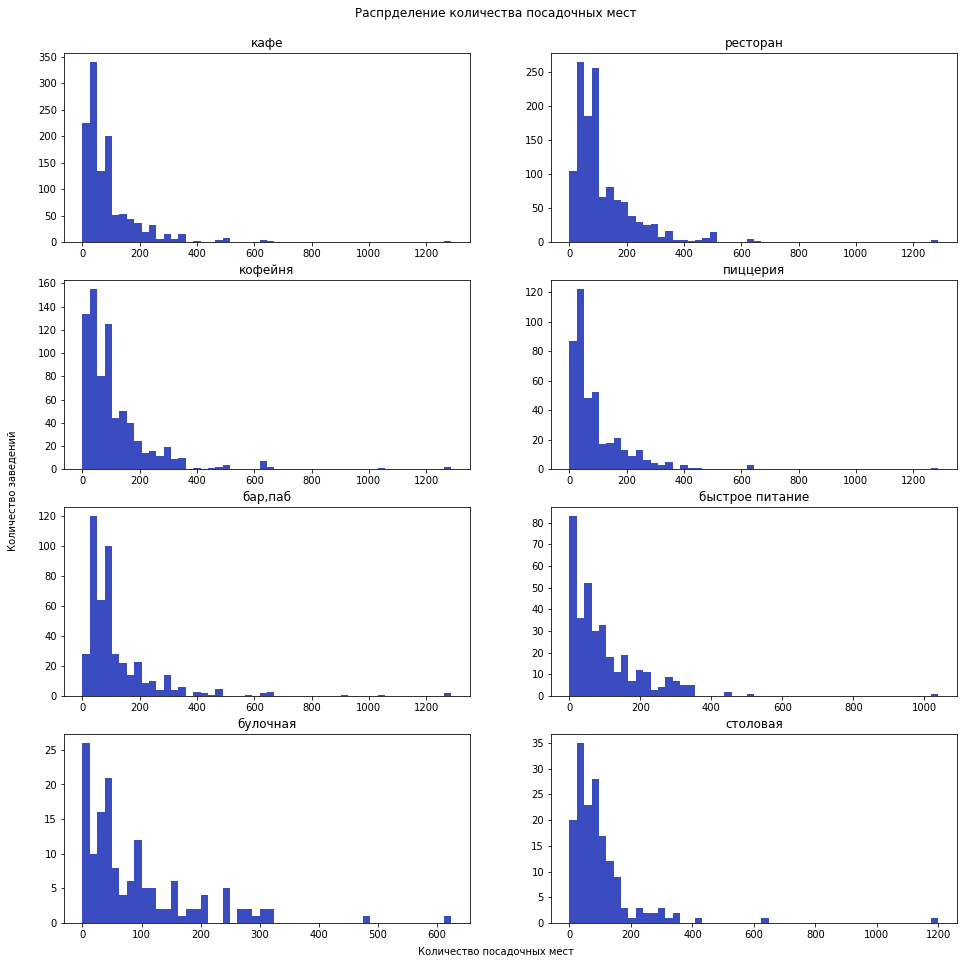

In [19]:
 #Создадим список с категориями заведений
category_list=places['category'].unique()
# Построим график распределения посадочных мест в каждой категории
fig, axs=plt.subplots(4, 2, figsize=(16,16))
axe = axs.ravel()
fig.text(0.5, 0.1, 'Количество посадочных мест', ha='center', va='center')
fig.text(0.08, 0.5, 'Количество заведений', ha='center', va='center', rotation='vertical')
plt.suptitle('Распрделение количества посадочных мест', y=0.92)
for i in range(len(category_list)): 
    places[places['category']==category_list[i]]['seats'].plot(kind='hist', ax=axe[i], bins=50, \
                                                               cmap='coolwarm')
    axe[i].set_title(category_list[i])
    axe[i].set_ylabel('')

Из полученных графиков видим, что основной объем выборки в каждой категории укладывается в диапозон до 400 мест, при этом также во всех категориях встречаются выбросы с количеством посадочных мест больше 600 и 1000. Скорее всего, эти данные ошибочные, проверим долю таких заведений.   

In [20]:
print('Доля заведений с посадочными больше 400:', round((places['seats']>400).mean(),4))

Доля заведений с посадочными больше 400: 0.0144


*Доля заведений с посадочными более 400 незначительна и составляет 1,4%, чтобы не терять информацию по этим заведениям, предлагается оставить данные строки и в дальнейших расчетах использовать медианные значения*

*Также в выборке присутствуют заведения с нулевыми посадочными местами, рассмотрим их подробнее*

In [21]:
places.query('seats==0')['category'].value_counts()

кафе               44
кофейня            24
ресторан           20
быстрое питание    18
булочная           11
пиццерия           10
столовая            5
бар,паб             4
Name: category, dtype: int64

*Основаная часть нулевых значений встречается в кафе и кофейнях, данные заведения могут работать на вынос. Также, чтобы не исключать информацию по этим заведениям, предалагаю оставить данные и использовать медианные значения в расчетах* 

#### Добавление дополнительных столбцов к основной таблице

In [22]:
# Добавим столбец с названием улиц
places['street']=places['address'].str.split(',').str[1]

In [23]:
# Добавим столбец с режимом работы
places['is_24_7']=places['hours'].str.contains('ежедневно','круглосуточно')


In [24]:
places['is_24_7'].mean()

0.6380274529740722

In [25]:
places['hours'].str.contains('ежедневно, круглосуточно').mean()

0.09278088459583121

In [26]:
# Для удобства заменим числовые значения в столбце chain на понятную запись
places['chain']=places['chain'].replace({1:'Сетевое', 0:'Несетевое'})

In [27]:
# Для удобства построения графиков дадим сокращенное название округов
places['district_short']=places['district'].replace({'Северный административный округ':'САО', \
                                               "Северо-Восточный административный округ":"СВАО",\
                                              "Северо-Западный административный округ":"СЗАО",\
                                              "Западный административный округ":"ЗАО",\
                                              "Центральный административный округ":"ЦАО",\
                                              "Восточный административный округ":"ВАО",\
                                              "Юго-Восточный административный округ":"ЮВАО",\
                                              "Южный административный округ":"ЮАО",\
                                              "Юго-Западный административный округ":"ЮЗАО"})

**Выводы по предобработке данных**

На этапе предобработки данных было установлено следующее:
- основная доля пропусков приходится на столбцы с ценами, при этом, как видно из матрицы, пропуски в столбцах price, avg_bill, middle_avg_bill в большинстве случаев совпадают. Доля пропусков в этих столбцах составляет более 50%, при этом нет дополнительной информации, с помощью которой можно заполнить такую высокую долю пропусков
- были выявлены и исключены три дубликата
- в датасете есть данные с аномальным количеством посадочных мест и средним чеком, чтобы сохранить остальную информацию по этим заведениям, строки с данными выбросами решено оставить 
- присвоены значения сетевыми и несетевым заведениям
- добавлены столбцы с названиями улиц, круглосуточностью работы
- для построения графиков добавлен столбец с сокращенными названиями округов

### Анализ данных

#### Исследование заведений по категориям 

In [28]:
# Найдем количество заведений в каждой категории
category=places.groupby('category').agg(amount=('name','count')).sort_values(by='amount')

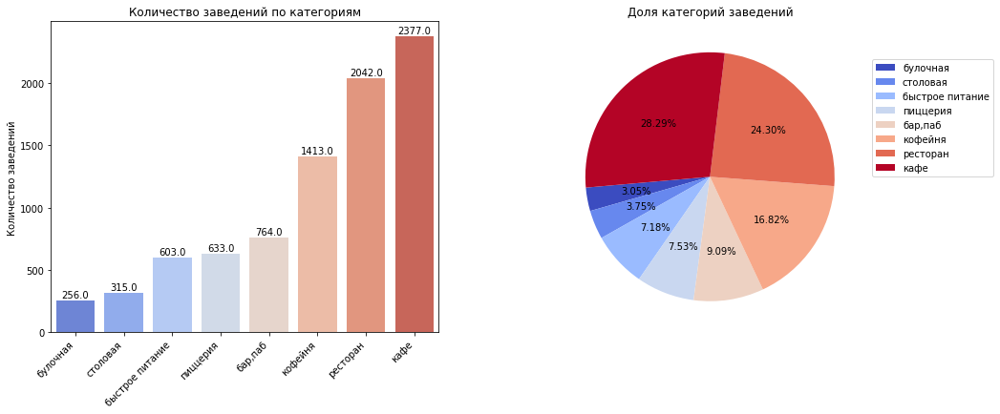

In [29]:
# Построим графики распределения количества заведений по категориям, а также их доли в общей выборке
fig= plt.figure(figsize=(16,6))
ax1=fig.add_subplot(1,2,1)
ax1=sns.barplot(x=category.index, y='amount', data=category, palette= "coolwarm")
for bar in ax1.patches:
           ax1.annotate(format(bar.get_height()),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=10, xytext=(0, 6),
                  textcoords='offset points')
ax2=fig.add_subplot(1,2,2)
ax2=category['amount'].plot(kind='pie', labels=None, label='', autopct='%.2f%%', \
                       legend=True, title='Доля категорий заведений',cmap="coolwarm",\
                             startangle=185, ax=ax2)
ax1.set_xticklabels(category.index, rotation=45, ha='right')
ax1.set_xlabel('')
ax1.set_ylabel('Количество заведений')
ax1.set_title('Количество заведений по категориям')
ax2.legend(category.index,loc=(1.02, 0.5))
# plt.show()
plt.savefig('saved_figure.png')

*Из представленных графиков видим, что более половины заведений составляют кафе и рестораны, следом за ними по популярности расположились кофейни, таким образом данные категории являются одними из наиболее конкурентных сегментов на рынке общепита, разница с последующими категориями более чем в два раза. Наименьшее количество заведений представлены в категории булочные*  

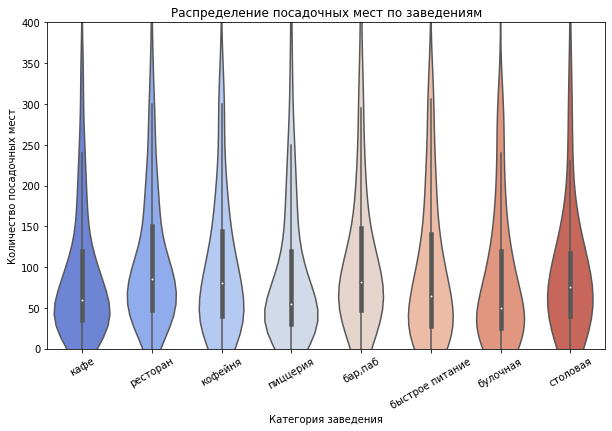

In [30]:
# Построим график распределения посадочных мест по категориям
# Так как ранее установили, что количество заведений с посадочными более 400 низкое,
# для наглядности, отсечем эти выбросы на графике
fig=plt.figure(figsize=(10,6))
sns.violinplot(x='category', y='seats', data=places, palette="coolwarm")
plt.xticks(rotation=30)
plt.ylim(0, 400)
plt.xlabel('Категория заведения')
plt.ylabel('Количество посадочных мест')
plt.title('Распределение посадочных мест по заведениям')
plt.show()


*Из полученного распределения видим, что наибольшее количество заведений во всех категориях имеет в районе 50-70 посадочных мест. При этом в категориях ресторан, кофейня, бар и быстрое питание большая доля заведений имеет более 100 посадочных мест. Наибольшее медианное значение в категориях ресторан, кофейня, бар и столовая*

In [31]:
# Рассчитаем медианные значения посадочных мест по категориям
seats=places.groupby('category').agg(seats=('seats','median')).sort_values(by='seats')

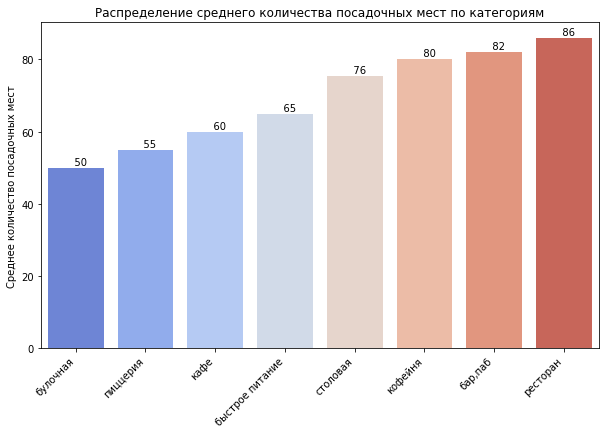

In [32]:
# Посторим график распределения медианных значений по категориям заведений
fig, ax1= plt.subplots(figsize=(10,6))
ax1=sns.barplot(x=seats.index, y='seats', data=seats, palette="coolwarm")
for bar in ax1.patches:
           ax1.annotate('{0:5.0f}'.format(bar.get_height()),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=10, xytext=(0, 6),
                  textcoords='offset points')
ax1.set_xticklabels(seats.index, rotation=45, ha='right')
ax1.set_xlabel('')
ax1.set_ylabel('Среднее количество посадочных мест')
ax1.set_title('Распределение среднего количества посадочных мест по категориям')
plt.show()

*Медианные количества в ресторанах, барах и кофейнях наиболее высокие и составляют 86, 82 и 80 мест соответственно. Однако необходимо учесть, что по данному параметру в датасете высокий процент пропущенных значений и точность данных может измениться при дополнительном уточнении пропусков*

In [33]:
# Найдем количество сетевых и несетевых заведений
print('Количество сетевых завдений:', len(places.query('chain=="Сетевое"')))
print('Количество несетевых завдений:', len(places.query('chain=="Несетевое"')))

Количество сетевых завдений: 3203
Количество несетевых завдений: 5200


*В Москве больше представлены несетевые заведения, рассмотрим, как распределен этот параметр по категориям*

In [34]:
# Найдем долю сетевых и несетевых заведений в каждой категории
chain=places.groupby(['category', 'chain']).agg(amount=('name','count')).reset_index()
chain=(chain
       .merge(category, left_on='category', right_index=True)
       .rename(columns={'amount_x':'cnt','amount_y':'total'}))
chain['ratio']=chain['cnt']/chain['total']


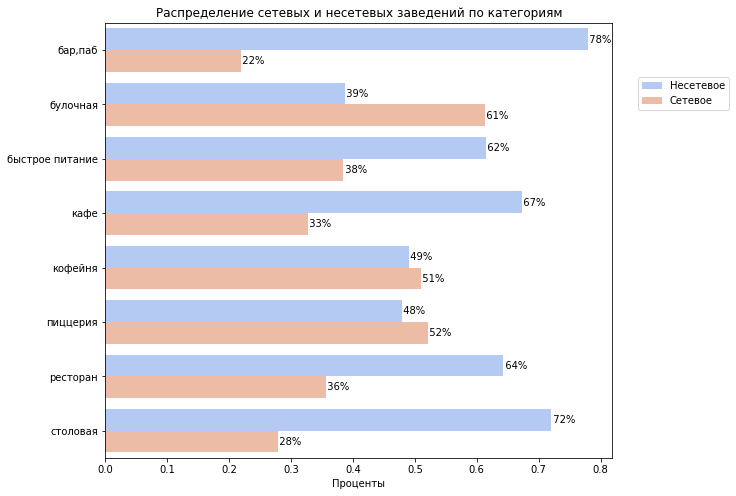

In [35]:
# Построим график распределения сетевых и несетевых заведений по категориям
fig= plt.figure(figsize=(20,8))
ax1=fig.add_subplot(1,2,1)
ax1=sns.barplot(y='category', x='ratio', hue='chain', data=chain, palette="coolwarm")
for bar in ax1.patches:
           ax1.annotate('{0:5.0%}'.format(bar.get_width()),
                        (bar.get_width()+0.015,
                   bar.get_y() + bar.get_height() / 2), 
                 ha='center', va='center',
                   size=10)
ax1.legend(loc=(1.05, 0.8))
ax1.set_xlabel('Проценты')
ax1.set_ylabel('')
ax1.set_title('Распределение сетевых и несетевых заведений по категориям')
plt.show()

*Из полученного распределения видим, что сетевые заведения преобладают в категориях булочная, кофейня, пиццерия. Данный фактор необходимо учитывать при открытии этих типов заведений, так как будут иметь место особенности конкуренции в основном с сетевыми заведениями. В остальных категориях подавляющую долю составляют несетевые заведения*

#### Анализ топ-15 популярных заведений

In [36]:
# Найдем названия заведения топ-15 популярных заведений
pop_name=(
    places
    .query('chain=="Сетевое"')
    .groupby(['name'])
    .agg(amount=('name','count'), category=('category', pd.Series.mode))
    .sort_values(by='amount', ascending=False).head(15))
# Для удобства построения графика дадим более сокращенное название
pop_name=pop_name.rename(index={'Кулинарная лавка братьев Караваевых':'Братья Караваевы'})


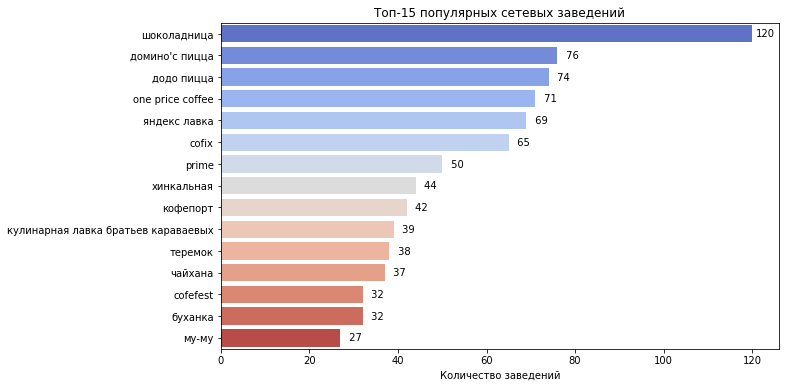

In [37]:
# Построим график распределения топ-15 сетевых заведений
fig, ax1 = plt.subplots(figsize=(10, 6))

ax1=sns.barplot(y=pop_name.index, x='amount', data=pop_name, palette="coolwarm")
for bar in ax1.patches:
           ax1.annotate('{0:3.0f}'.format(bar.get_width()),
                        (bar.get_width()+3,
                   bar.get_y() + bar.get_height() / 2), 
                 ha='center', va='center',
                   size=10)
ax1.set_xlabel('Количество заведений')
ax1.set_ylabel('')
ax1.set_title('Топ-15 популярных сетевых заведений')
plt.show()

In [38]:
# Зададим список топ-15 заведений
pop_name_list=pop_name.index
# Построим распределение топ-15 заведений по категориям
top_place=(places
           .query('name in @pop_name_list')
           .groupby('category')
           .agg(amount=('name','value_counts'))
           .sort_values(by='amount', ascending=False)
            .reset_index())


In [39]:
# Построим график распределения топ-15 заведений по категориям
fig = px.bar(top_place, 
             x='amount',
             y='category',  
             color='name',
            color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title='Распределение топ-15 заведений по категориям',
                   xaxis_title='Количество заведений',
                   yaxis_title='',
                  barmode='stack',
                 yaxis={'categoryorder':'total ascending'}, title_x=0.5)
fig.show()

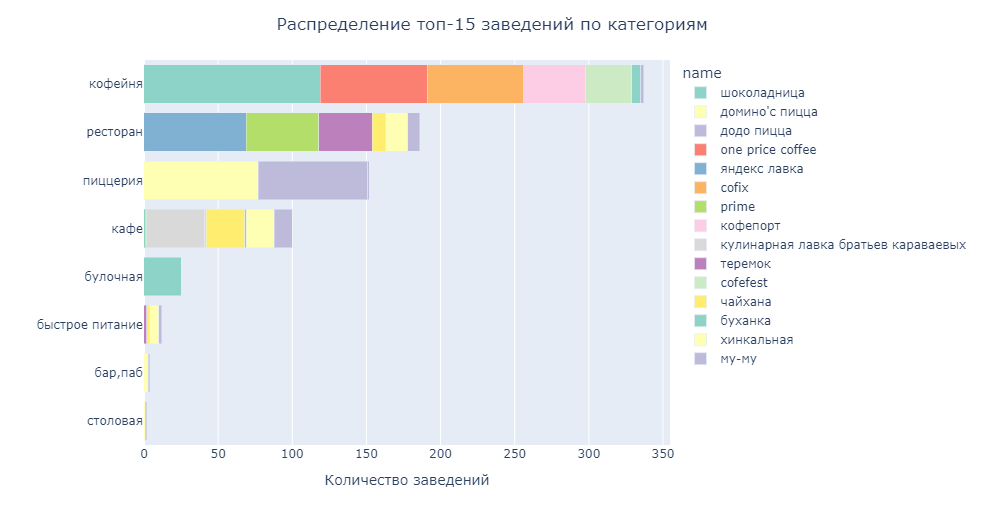

*Из представленного графика видим, что большая часть популярных сетевых заведений относится к категории кофейни, при этом наиболее представлена сеть Шоколадница. Количество заведений в 1,5 раза выше, чем у следующей за ней кофейни One price coffe. В целом, в данной категории представлены наиболее известные сети кофеен, которые предлагают бюджетный кофе для потребителя с географическим расположением, обеспечивающим высокий клиентский поток в этих заведениях.*

*Следом идет категория рестораны, при этом общее их количество в сетевых заведениях почти в два раза меньше. Наибольшее количество точек у Яндекс Лавки, однако, данные точки не являются объектами общественного питания и представляют пункты сбора заказов, таким образом, наиболее популярное сетевое заведение в данной категории сеть ресторанов Prime. Также широко представлены пиццерии Dominos и Dodo, количество заведений в остальных категорий значительно меньше. При этом некоторые сет отнесены к разным категориям, возможно, она варьируется в зависимости от расположения заведения.*

*В целом, все эти заведения объединяет широкая доступность потребителю как в ценовом сегменте, так и локациями*

#### Анализ заведений по расположению и рейтингу

In [40]:
# Рассмотрим, какие районы представлены в датасете
places['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [41]:
# Найдем распределение заведений по категориям в каждом районе
district=places.pivot_table(index='district_short', columns='category', values='name', aggfunc='count')
# district['total']=district[district.columns].sum(axis=1)
# district=district.sort_values(by='total')

In [101]:
# Построим график распределения заведений по категориям в каждом районе
fig = px.bar(district, 
             x=district.columns,
             y=district.index,  
             color='category', 
             color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределение категорий заведений по районам Москвы',
                   xaxis_title='Количество заведений',
                   yaxis_title='',
                 yaxis={'categoryorder':'total ascending'}, title_x=0.5)
fig.show()


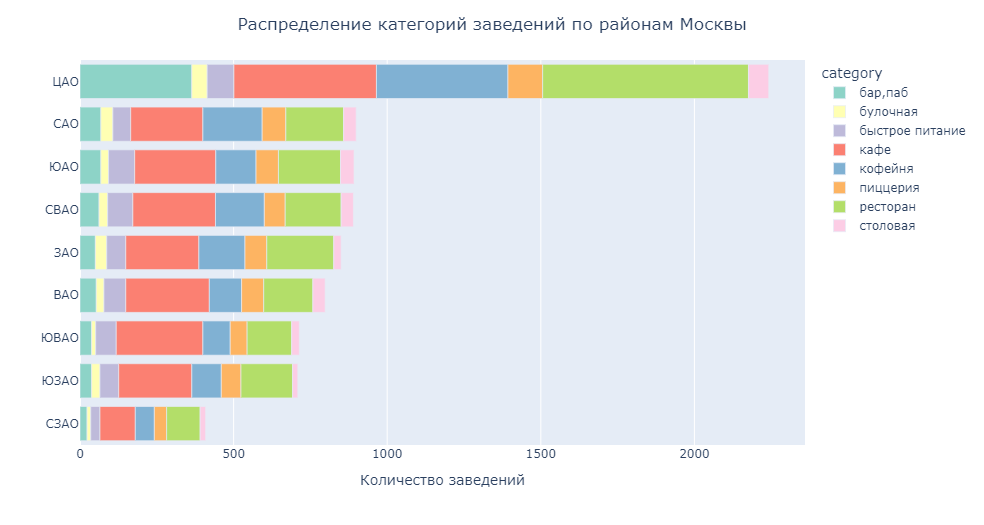

*Из представленного графика видим, что наибольшее количество заведений расположено в ЦАО, суммарное количество более чем в два раза превосходит следующиее за ним округи. Наименьшее количество расположено в СЗАО. При этом, в ЦАО наиболее представленной категорией являются рестораны, тогда как в остальных округах наиболее популярны кафе.* 

*Для более точного анализа отобразим доли категорий заведений по районам*

In [43]:
# Построим график с долей каждой категории в районах Москвы
fig = px.histogram(district, 
             x=district.columns,
             y=district.index,
             barnorm = "percent",
             color='category',
            color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Доля категорий заведений по районам',
                   xaxis_title='Доля категории',
                   yaxis_title='Название района',
                 yaxis={'categoryorder':'total ascending'}, title_x=0.5)
fig.show()

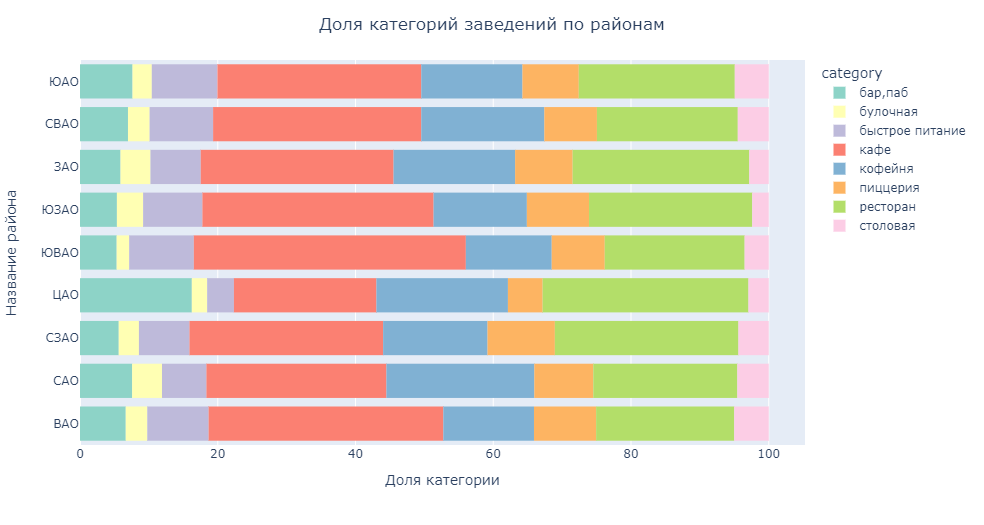

*Из полученного распределения видим, что в ЦАО доля ресторанов составляет 30%, кафе 20%, тогда как в остальных округах обратное соотношение. Количество кофеен в каждом районе занимает 3-ю позицию и составляет от 12 до до 21%, при этом наиболее высокая доля кофеен в САО. Также особенность профиля заведений в ЦАО является невысокая доля пиццерий, в нем более популярны бары, тогда как в остальных районах по популярности за кофейнями следуют пиццерии*

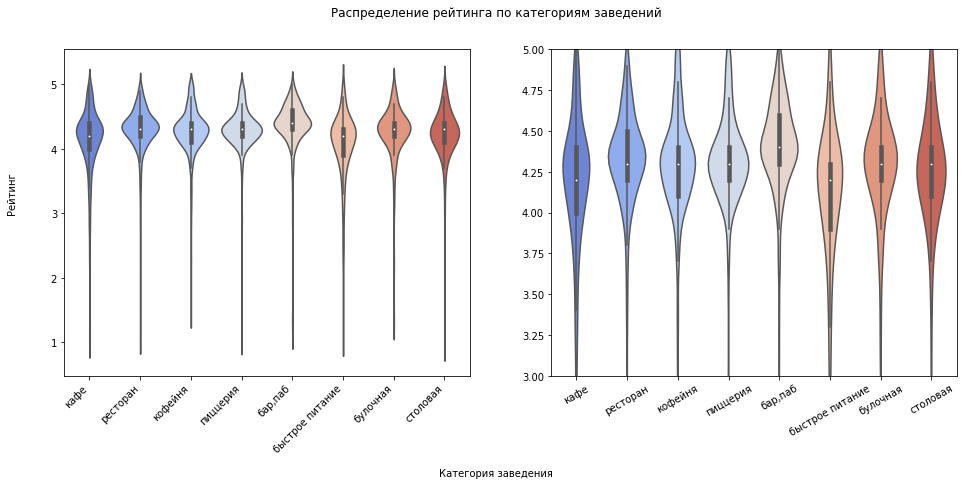

In [44]:
# Построим график распределения рейтингов по категориям
# для наглядности сузим границы исследования на 2-м графике
fig=plt.figure(figsize=(16,6))
fig.text(0.5, -0.1, 'Категория заведения', ha='center', va='center')
fig.text(0.08, 0.5, 'Рейтинг', ha='center', va='bottom', rotation='vertical')
ax1=fig.add_subplot(1,2,1)
ax1=sns.violinplot(x='category', y='rating', data=places, palette='coolwarm')
ax2=fig.add_subplot(1,2,2)
ax2=sns.violinplot(x='category', y='rating', data=places, palette='coolwarm')
plt.xticks(rotation=30)
ax1.set_xlabel('')
ax1.set_ylabel('')
ax2.set_xlabel('')
ax2.set_ylabel('')
plt.suptitle('Распределение рейтинга по категориям заведений')
ax2.set_ylim(3,5)
ax1.set_xticklabels(places['category'].unique(), rotation=45, ha='right')
plt.show()

*Из полученного графика видим, что основная доля заведений в каждой категории имеет рейтинг до 4,5, при этом в барах объем выборки заведений, имеющих больший рейтинг наиболее высокий, в заведениях быстрого питания наиболее низкий. При этом наиболее высокая доля заведений с рейтингом заведений менее 4 характерна для кафе и заведений быстрого питания. Медианное значение рейтинга наиболее высокое высокое в барах, однако, для данного параметра важно учесть наличие выбросов, так как они характеризуют отрицательные отзывы, поэтому построим распределение среднего рейтинга для каждой категории*

In [45]:
# Найдем распределение среднего рейтинга по категориям
rating=places.groupby('category').agg(rating=('rating','mean')).round(2)


In [46]:
# Построим график распределения среднего рейтинга по категориям заведений
fig = px.line(rating, x=rating.index, y='rating', markers=True)
fig.update_layout(title='Средний рейтинг в зависимости от вида заведения',
                   xaxis_title='',
                   yaxis_title='Средний рейтинг', title_x=0.5)
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

*При визуализации средних значений рейтинга наиболее выражено различие в оценках заведений по категориям. Рейтинг кафе и мест быстрого питания значительно ниже баров, и составляет 4.39 и 4.05 баллов соответсвенно* 

In [47]:
# Для визуализации распределения рейтинга в зависимости от разных параметров, 
# сгруппируем значения и зададим функцию для нового столбца
def rating_spread(rating):
    if rating>=0 and rating<3.6:
        return 'очень низкий (0-3.6)'
    if rating>=3.6 and rating<3.9:
        return 'низкий (3.6-3.9)'
    if rating>=3.9 and rating<4.2:
        return 'средний (3.9-4.2)'
    if rating>=4.2 and rating<4.5:
        return 'выше среднего (4.2-4.5)'
    if rating>=4.5:
        return 'высокий (>4.5)'

In [48]:
# Применим функцию к рейтингу заведений
places['rating_category']=places['rating'].apply(rating_spread)

In [49]:
# Найдем распределение средних рейтингов по районам
rating_mean=places.groupby('district')['rating'].mean().round(2)

In [50]:
# Найдем распределение заведений по категориям рейтингов в зависиомости от районов
rating_spread=(places
               .pivot_table(index='district_short', columns='rating_category', \
                            values='name', aggfunc='count'))

In [51]:
# Построим распределение долей заведений с разными категориями рейтингов по районам
fig = px.histogram(rating_spread, 
             x=rating_spread.columns,
             y=rating_spread.index,
             barnorm = "percent",
             color='rating_category',
            color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределений категорий рейтинга заведений по районам в долях',
                   xaxis_title='Доля заведений',
                   yaxis_title='', title_x=0.5
)
fig.show()

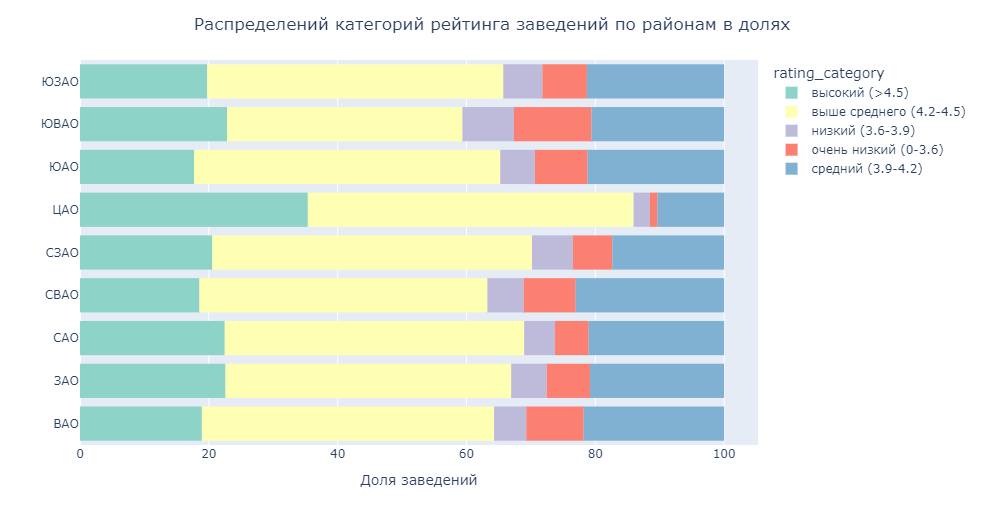

*Из представленного распрделения видим, что во всех округах более половины заведений имеют рейтинг более 4.2,при этом рейтинг более 4.5 наиболее часто встречается в ЦАО, однако, в других округах доля таких заведений также составляет более 40%, исключение составляет ЮВАО, где доля таких заведений 36%, при этом в данном округе наиболее высокая доля заведений с рейтингом менее 3.6* 

In [52]:
# Найдем распределение долей заведений с разными категориями рейтингов по категориям заведений
category_spread=(places
                 .pivot_table(index='category', columns='rating_category', \
                              values='name', aggfunc='count'))

In [53]:
# Построим распределение долей заведений с разными категориями рейтингов по категориям заведений
fig = px.histogram(category_spread, 
             x=category_spread.columns,
             y=category_spread.index,
             barnorm = "percent",
             color='rating_category',
            color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределений категорий рейтинга по заведениям в долях',
                   xaxis_title='Доля заведений',
                   yaxis_title='', title_x=0.5,     
)
fig.show()

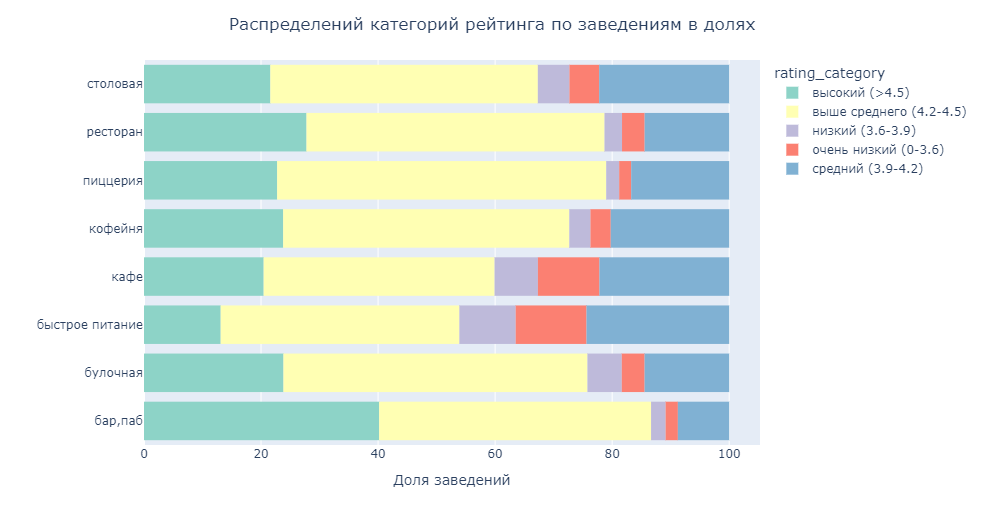

*Из представленного распределения видим, что наибольшее число заведений с рейтингом более 4.5 в категории бар, при этом во всех категориях доля заведений с рейтингом выше 4.2 составляет около 80%, исключение составляют кафе и места быстрого питания, где доля таких заведений немного больше 50%. При этом в этих же категориях очень высокая доля заведений с рейтингом менее 3.6*

In [54]:
# Построим карту распределения среднего рейтинга по округам Москвы
# загружаем JSON-файл с границами округов Москвы
state_geo = '/datasets/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_mean,
    columns=[rating_mean.index, 'rating'],
    key_on='feature.name',
    fill_color='GnBu',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

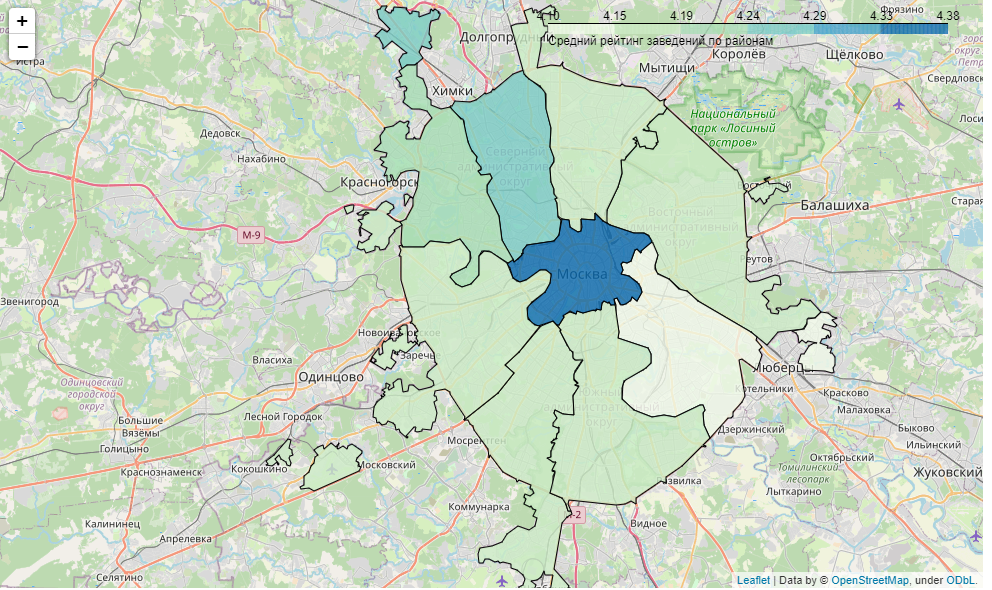

*Из построенного графика видим, что наиболее высокий средний средний рейтинг в ЦАО, где он составляет более 4.37, следом за ним по средему рейтингу следует САО, наиболее низкий средний рейтинг в ЮВАО -4.1*

In [55]:
# Отобразим заведения из датасета на карте Москвы
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
places.apply(create_clusters, axis=1)

# выводим карту
m

*На карте видим высокую концентрацию заведений в ЦАО и относительно равномерное распределение заведений по другим районам Москвы*

In [56]:
# Найдем топ-15 улиц по количеству расположенных на них заведений
top_streets=(places.groupby(['street'])
             .agg(amount=('name','count')).sort_values(by='amount', ascending=False)
             .reset_index()
             .head(15))
# Для отображения на карте добавим координыты заведений
street_spread=(
    top_streets.merge(places[['street', 'name', 'lat', 'lng', 'rating']], on='street', how='left')
    .sort_values(by='amount'))


In [57]:
# Создадим список с названиями этих улиц
top_streets_list=top_streets['street']

In [58]:
# Найдем распределение категорий заведений по этим улицам
street=(places
        .query('street in @top_streets_list')
        .pivot_table(index='street', columns='category', values='name', aggfunc='count')
       )

In [59]:
# Построим график распределения категорий заведений по этим улицам
fig = px.bar(street, 
             x=street.columns,
             y=street.index,  
             color='category',
             color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределение категорий заведений по улицам',
                   xaxis_title='Количество заведений',
                   yaxis_title='',
                  barmode='relative',
                 yaxis={'categoryorder':'total ascending'}, title_x=0.5)
fig.show()

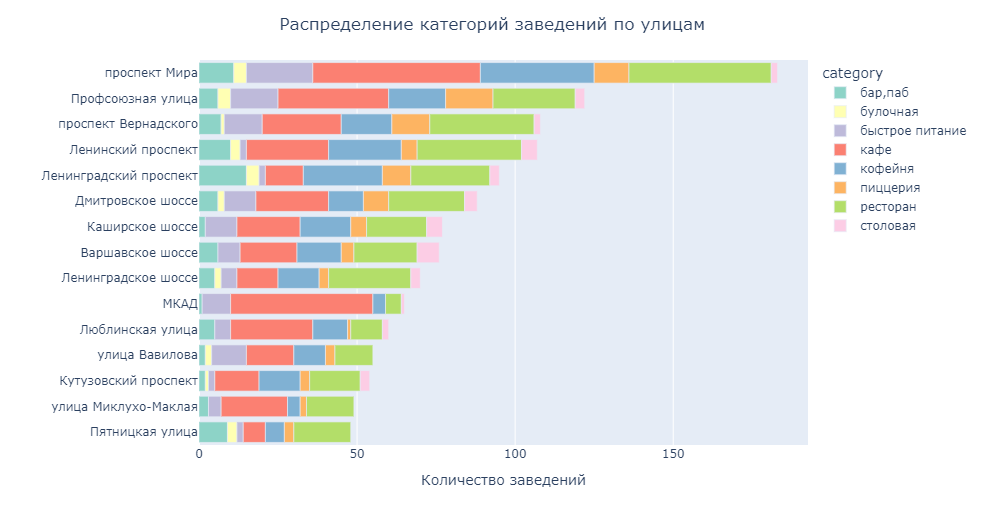

*Из полученного распределения видим, что наибольшее количество заведений расположено на наиболее протяженных улицах Москвы, а также шоссе и проспектах. Пятницкая улица является местом высокой концентрации мест общепита в центре, поэтому несмотря на невысокую протяженность также попала в данный список. Наиболее представлены на этих улицах кафе и рестораны. На всех улицах за исключением Пятницкой и Кутузовского проспекта также отмечается высокая доля столовых и мест быстрого питания*

In [60]:
# # Отобразим на карте заведения на данных улицах
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)
street_spread.apply(create_clusters, axis=1)
m

*На карте видим, что данные улицы расположены в удалении от центра*

In [61]:
# Найдем улицы, на которых расположено по одному заведению
# Сгруппируем улицы по названиям
low_street=places.groupby(['street']).agg(amount=('name','count')).reset_index()
# Выделим список с названиями таких улиц
low_street_list=low_street.query('amount==1')['street']

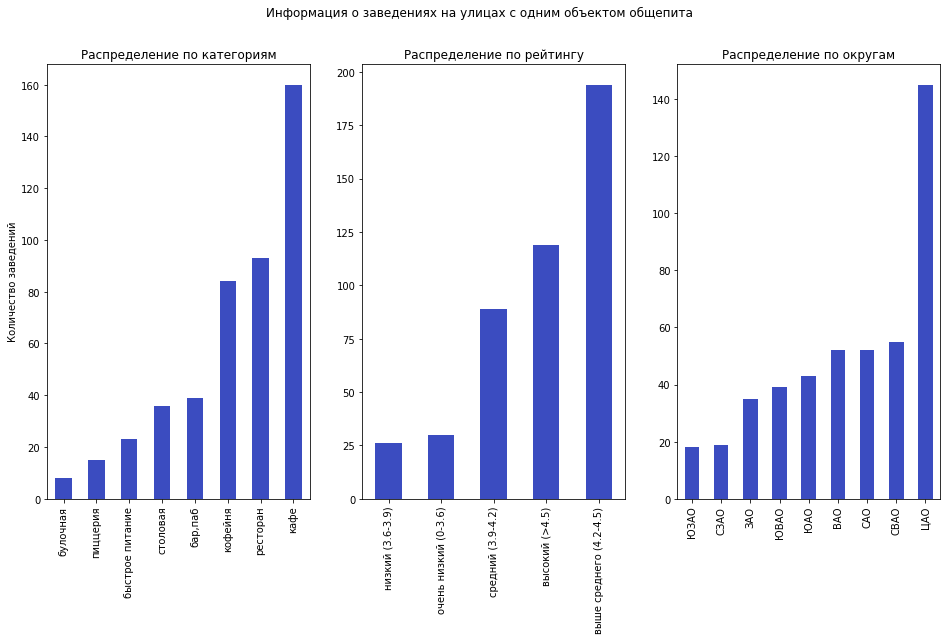

In [62]:
# Отобразим на графиках, к каким категориям относятся данные заведения, их средний рейтинг,
# а также в каких районах они представлены
fig=plt.figure(figsize=(16,8))
# fig.text(0.5, -0.1, 'Категория заведения', ha='center', va='center')
# fig.text(0.08, 0.5, 'Рейтинг', ha='center', va='bottom', rotation='vertical')
ax1=fig.add_subplot(1,3,1)
ax1=(
    places
    .query('street in @low_street_list')
    .groupby('category').agg({'name':'count'}).sort_values(by='name')
    .plot(kind='bar', legend=False, ax=ax1, cmap='coolwarm')
)
ax2=fig.add_subplot(1,3,2)
ax2=(
    places
    .query('street in @low_street_list')
    .groupby('rating_category').agg({'name':'count'}).sort_values(by='name')
    .plot(kind='bar', legend=False, ax=ax2, cmap='coolwarm')
)
ax3=fig.add_subplot(1,3,3)
ax3=(
    places
    .query('street in @low_street_list')
    .groupby('district_short').agg({'name':'count'}).sort_values(by='name')
    .plot(kind='bar', legend=False, ax=ax3, cmap='coolwarm')
)
ax1.set_xlabel('')
ax1.set_ylabel('Количество заведений')
ax1.set_title('Распределение по категориям')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.set_title('Распределение по рейтингу')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.set_title('Распределение по округам')
plt.suptitle('Информация о заведениях на улицах с одним объектом общепита')
plt.show()

*Из полученных графиков видим, что одиночные заведения на отдельных улицах представлены в основном в категории кафе, следом идут рестораны и кофейни, данные заведения имеют высокий рейтинг и расположены в основном в ЦАО* 

#### Анализ цен в заведениях общепита Москвы

In [63]:
# Найдем медианный средний чек в каждом округе Москвы
avg_prices=places.groupby('district').agg(avg_price=('middle_avg_bill', 'median')).sort_values(by='avg_price')


In [64]:
# Наложим значение медианного среднего чека по районам Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=avg_prices,
    columns=[avg_prices.index, 'avg_price'],
    key_on='feature.name',
    fill_color='GnBu',
    fill_opacity=0.8,
    legend_name='Медианный средний чек заведений по районам',
).add_to(m)

# выводим карту
m

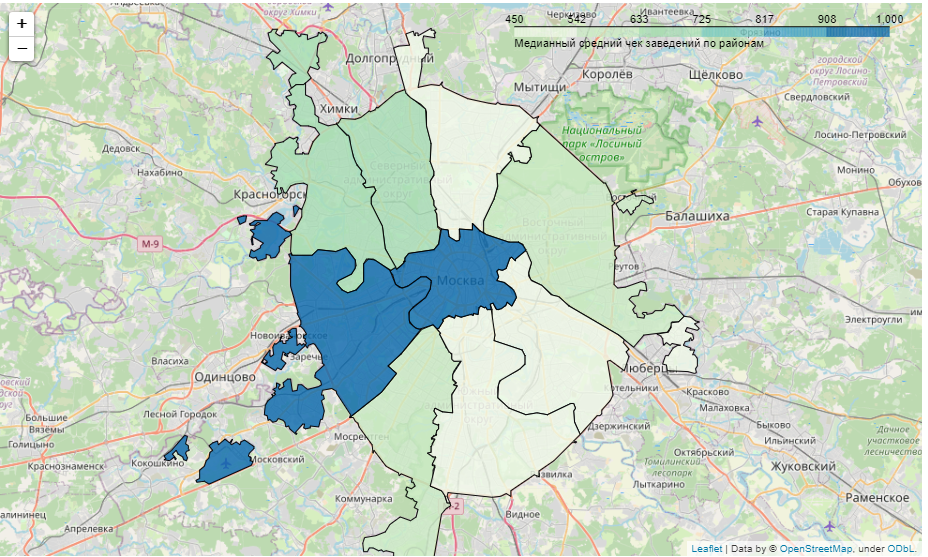

*Из представленного графика видим, что наиболее высокий средний чек в ЦАО и ЗАО и составляет 1000 рублей, наиболее низкий средний чек в СВАО, ЮВАО, ЮАО*

In [65]:
# Найдем рапределение ценовых категорий заведений по районам
price_category=(places
                .groupby(['price', 'district_short'])
                .agg(price_category=('name', 'count'))
                .sort_values(by='price_category').reset_index())

In [66]:
# Построим график распределения ценовых категорий заведений по районам
fig = px.bar(price_category, 
             x=price_category['price_category'],
             y=price_category['district_short'],
             color='price',
             color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределение ценовых категорий заведений по районам',
                   yaxis_title='',
                  xaxis_title='Количество заведений',
                 yaxis={'categoryorder':'total ascending'},
                 xaxis={'visible': False}, title_x=0.5)
fig.show()

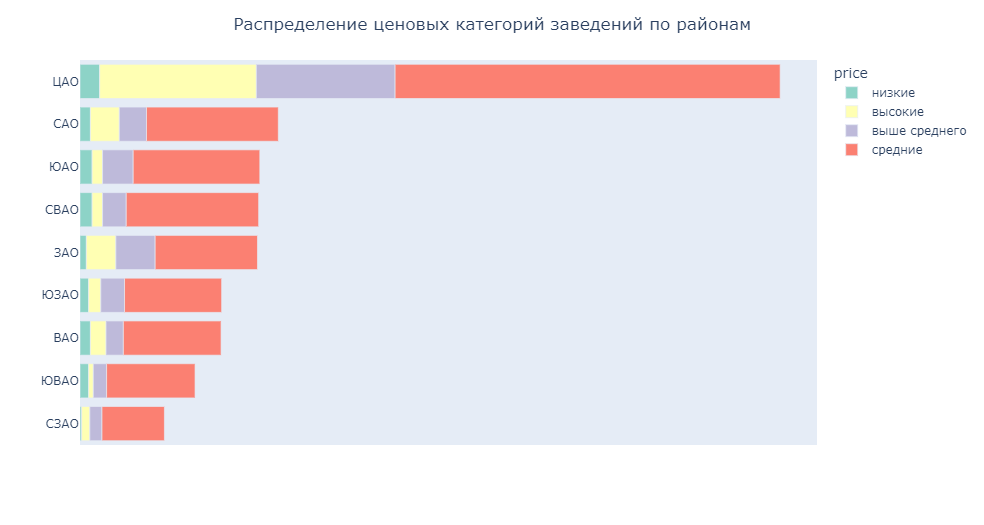

*Из представленного распределения видим, что во всех округах преобладают заведения в средней ценовой категории, наиболее высокая доля заведений с высокими ценами в ЦАО, при этом ЗАО и САО также имеют относительно высокое количество заведений в высших ценовых сегмантах по сравнению с другими округами*

In [67]:
# Чтобы оценить изменение цен при удалении от центра, по координатам найдем расстояние от координат
# центра Москвы, до координат заведений
# Зададим фукнцию расчета километров по координатам
def km(row):

    lat=row['lat']
    lng=row['lng']
    # Переведем градусы в радианы 
    lon1, lat1, lon2, lat2 = map(radians, [lng, lat,37.618423,  55.751244])
    # зададим формулу гаверсинуса 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    #Радиус земли в км 6371
    dist = 6371 * c
    return dist 

In [68]:
# Применим функцию для расчета км
places['km']=places.apply(km, axis=1)

In [69]:
# Для удобства визуализации зададим функцию распределения расстояния от центра по категориям
# Границей центра будем считать расстояние 6 км
def distance(km):
    if km<=3:
        return 'до 3 км'
    if km>3 and km<=10:
        return '3-10 км'
    if km>10 and km<=15:
        return '10-15 км'
    if km>15 and km<=21:
        return '15-20 км'

In [70]:
# Создадим новый столбец с категориями по расстоянию
places['distance_category']=places['km'].apply(distance)

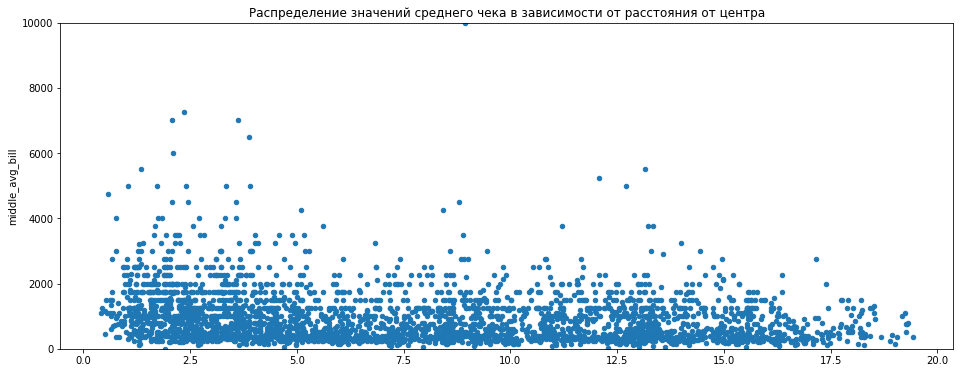

In [71]:
# Построим график зависимости среднего чека от расстояния
places.plot(kind='scatter', x='km', y='middle_avg_bill', figsize=(16,6), cmap='coolwarm')
plt.ylim(0, 10000) #так как в данных присутствует один выброс, установим лимит для наглядности
plt.title('Распределение значений среднего чека в зависимости от расстояния от центра')
plt.xlabel('')
plt.show()

Из распределения средних чеков по расстоянию от центра видим, что при расстоянии до 5 км больше заведений имеют средний чек выше 1000 рублей, тогда как на более дальних расстояних основная выборка зведений укладывается в значение до 1000. Также на расстоянии до 5 км встречается больше заведений со средним чеком выше 2000

In [72]:
# Для удобства построения графика приведем километры к целым числам
places['km']=places['km'].astype(int)

In [73]:
# Найдем изменение среднего чека по расстоянию от центра
km_places=places.groupby('km').agg({'middle_avg_bill':'median'})

In [74]:
# Построим график изменения среднего чека по расстоянию от центра
fig = px.line(km_places, x=km_places.index, y='middle_avg_bill', markers=True)
fig.update_layout(title='Средний чек в зависимости от расстояния от центра',
                   xaxis_title='Км',
                   yaxis_title='Средний чек', title_x=0.5)
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

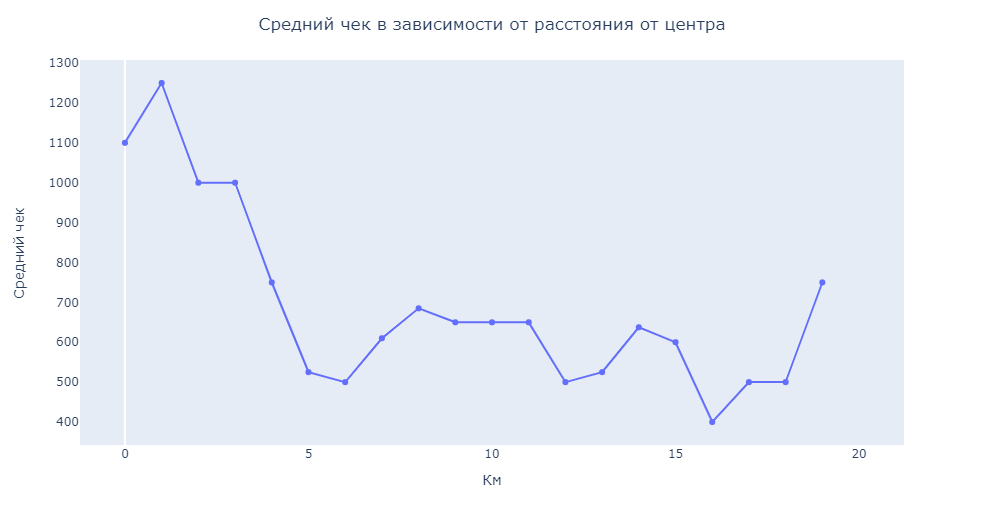

*По представленному распределению видим как значительно падает значение среднего чека при удалении от центра, на расстоянии 5-6 км наблюдается снижение значения среднего чека более чем в два раза. Значения среднего чека после 4 км в зависимости от расстояния колеблются от 450 до 800 рублей* 

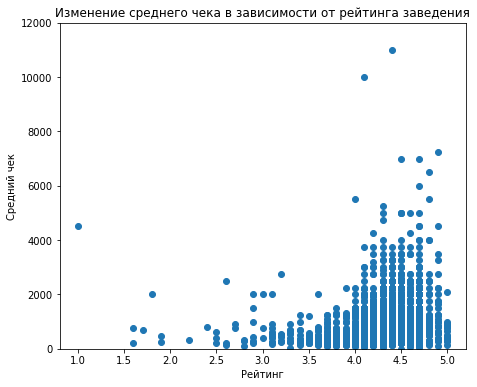

In [75]:
# Построим распределние среднего чека в зависимости от рейтинга заведения
fig= plt.figure(figsize=(16,6))
ax1=fig.add_subplot(1, 2, 1)
ax1.scatter('rating','middle_avg_bill', data=places,  cmap='coolwarm')
ax1.set_ylim(0,12000)
ax1.set_xlabel('Рейтинг')
ax1.set_ylabel('Средний чек')
ax1.set_title('Изменение среднего чека в зависимости от рейтинга заведения')
plt.show()

*По построенному распределению видим, что заведения с рейтингом 4.3-4.6 чаще остальных имеют средний чек выше 2000. Заведения с рейтингом ниже 3.5 имеют наиболее низкие средние чеки в районе 400 рублей*  

#### Анализ других показателей

Для более детального анализа построим графики зависимостей нескольких факторов, определяющих средний чек и рейтинг заведений

In [76]:
# Найдем распределение среднего чека в зависимости от категории заведения и категории рейтинга
price_rating=(
    places.groupby(['category', 'rating_category'])
    .agg(price=('middle_avg_bill','median')).reset_index())


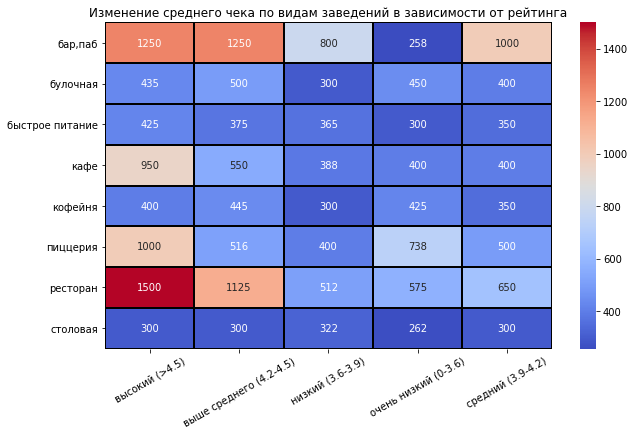

In [77]:
# Найдем распределение среднего чека в зависимости от категории заведения и категории рейтинга
price_rating=places.pivot_table(index='category', columns='rating_category', values='middle_avg_bill', aggfunc='median')
# Построим тепловую карту среднего чека в зависимости от категории заведения и категории рейтинга
fig=plt.figure(figsize=(10,6))
sns.heatmap(price_rating, annot=True, cmap='coolwarm', fmt='.0f', linewidths=1, linecolor='black')
plt.ylabel('')
plt.xlabel('')
plt.xticks(rotation=30)
plt.title('Изменение среднего чека по видам заведений в зависимости от рейтинга')
plt.show()

*Из представленного графика видим, что наиболее высокий средний чек в категория бар и ресторан, причем это значение сильно варьируется в зависимости от рейтинга заведния, места с рейтингом выше 4.2 имеют средний чек в два раза выше остальных заведений. В пиццерии и кафе заведения с рейтингом выше 4.5 имеют средний чек в два раза выше по сравнению с остальными заведениями, при этом видим высокий средний чек в пиццерии с очень низким рейтингом, однако доля таких заведений 2%, поэтому данные не репрезентативны* 

*В остальных категориях средний чек колеблется в районе 300-400 рублей, причем нет такой сильно выраженной зависимости от рейтинга заведения*

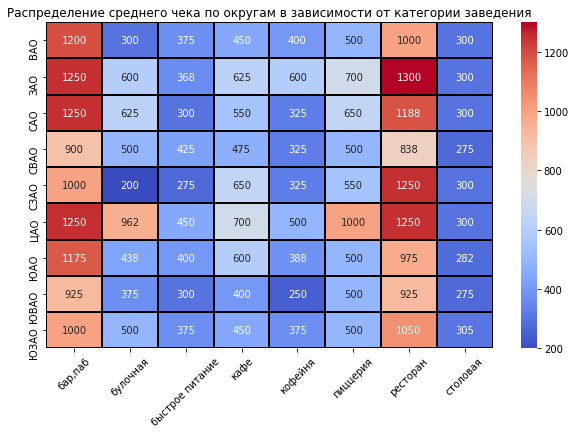

In [78]:
# Найдем распределение среднего чека в зависимости от категории заведения и округа
price_district=places.pivot_table(index='district_short', columns='category', values='middle_avg_bill', aggfunc='median')
# Построим тепловую карту среднего чека в зависимости от категории заведения и округа
fig=plt.figure(figsize=(10,6))
sns.heatmap(price_district, annot=True, cmap='coolwarm', fmt='.0f', linewidths=1, linecolor='black')
plt.ylabel('')
plt.xlabel('')
plt.xticks(rotation=45)
plt.title('Распределение среднего чека по округам в зависимости от категории заведения')
plt.show()

*При разбивке среднего чека по категориям в каждом районе видим, что в ЗАО и САО почти во всех категориях средний чек на уровне ЦАО. Во всех округах бары и рестораны имеют наиболее высокий средний чек*

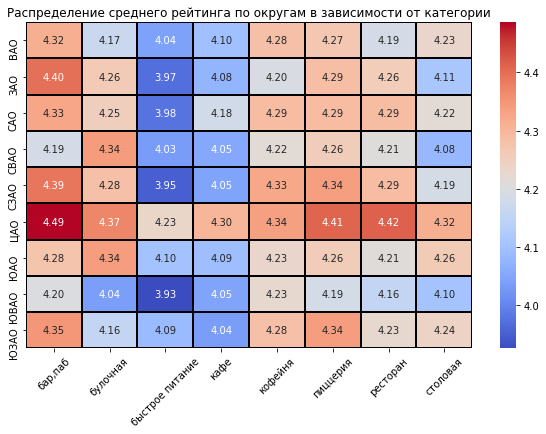

In [79]:
fig=plt.figure(figsize=(10,6))
rating_district=places.pivot_table(index='district_short', columns='category', values='rating', aggfunc='mean')
sns.heatmap(rating_district, annot=True, cmap='coolwarm', fmt='.2f', linewidths=1, linecolor='black')
plt.ylabel('')
plt.xlabel('')
plt.xticks(rotation=45)
plt.title('Распределение среднего рейтинга по округам в зависимости от категории')
plt.show()

*На карте видим, что во всех категориях заведений самый высокий рейтинг в ЦАО. Во всех округах бары имеют наиболее высокий рейтинг, тогда как наиболее низкий в быстром питании и кафе*

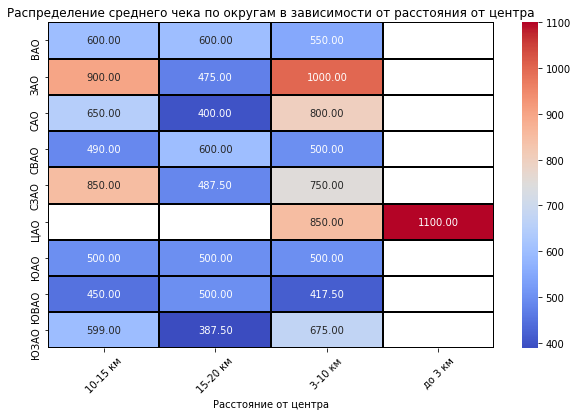

In [80]:
# Найдем изменение среднего чека при удалении от центра с разбивкой по районам
price_km=places.pivot_table(index='district_short', columns='distance_category', values='middle_avg_bill', aggfunc='median')
# Построим график изменения среднего чека при удалении от центра с разбивкой по районам
fig=plt.figure(figsize=(10,6))
sns.heatmap(price_km, annot=True, cmap='coolwarm', fmt='.2f', linewidths=1, linecolor='black')
plt.ylabel('')
plt.xlabel('Расстояние от центра')
plt.xticks(rotation=45)
plt.title('Распределение среднего чека по округам в зависимости от расстояния от центра')
plt.show()

*В СЗАО, САО и ЗАО значения среднего чека высокие на расстоянии от центра 6-10 км. Заведения в СЗАО и ЗАО имеют высокий средний чек и при удалении от центра до 15 км*


In [81]:
# Найдем количество круглосуточных заведений
places['is_24_7'].value_counts()

True     5020
False    2848
Name: is_24_7, dtype: int64

*Доля круглосуточных заведений составляет менее 10%*

In [82]:
# Рассмотрим влияет ли круглосуточность работы заведения на средний чек
working_hour=(
    places.groupby(['category', 'is_24_7'])
    .agg(price=('middle_avg_bill','median')).reset_index())

In [83]:
fig = px.bar(working_hour, 
             x=working_hour['price'],
             y=working_hour['category'],
             color='is_24_7',
             text='price',
             color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Средний чек в зависимости от режима работы заведения',
                   yaxis_title='',
                 yaxis={'categoryorder':'total ascending'},
                 xaxis={'visible': False}, title_x=0.5)
fig.show()

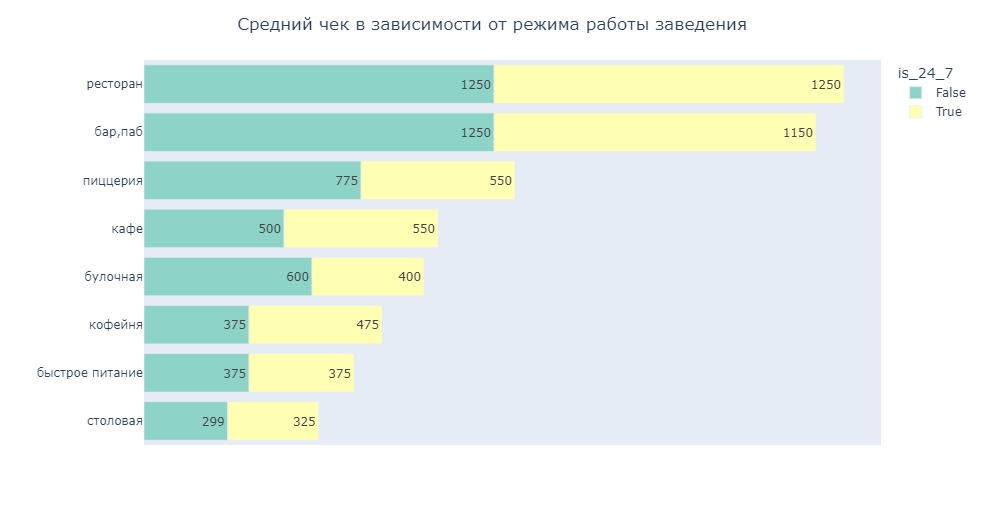

*На графике видим, что в кофейнях средний чек значительно варьируется в зависимости от круглосуточности работы, в остальных заведениях чек либо ниже, либо без изменений. Рассмотрим подробнеей круглусуточные кофейни*

In [84]:
# Найдем среднюю цену за чашку кофе в круглосуточных и обычных кофейнях
coffee_24=(
    places.query('category=="кофейня"')
    .groupby('is_24_7')
    .agg(avg_price=('middle_avg_bill','median'), coffee_price=('middle_coffee_cup', 'median'))
    .reset_index())
coffee_24

,is_24_7,avg_price,coffee_price
0,False,375.0,165.0
1,True,475.0,170.0


In [85]:
# Рассмотрим, для какого количества круглосуточных кофеен есть информация о среднем счете
places.query('category=="кофейня" and is_24_7 and middle_avg_bill.notnull()') 

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,district_short,rating_category,km,distance_category
58,coffeekaldi's,кофейня,"Москва, Угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,Сетевое,NaN,Угличская улица,True,СВАО,средний (3.9-4.2),16,15-20 км
139,шеф бургер,кофейня,"Москва, Дмитровское шоссе, 116Д",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.901734,37.548499,4.1,средние,Средний счёт:300 ₽,300.0,NaN,Сетевое,120.0,Дмитровское шоссе,True,СВАО,средний (3.9-4.2),17,15-20 км
254,ай эм конфидент,кофейня,"Москва, Староватутинский проезд, 14",Северо-Восточный административный округ,"ежедневно, 08:00–22:00",55.875832,37.665830,4.2,средние,Средний счёт:350–500 ₽,425.0,NaN,Несетевое,100.0,Староватутинский проезд,True,СВАО,выше среднего (4.2-4.5),14,10-15 км
279,сладкие минуты,кофейня,"Москва, Староватутинский проезд, 14",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.875692,37.665722,3.9,NaN,Средний счёт:260–300 ₽,280.0,NaN,Несетевое,100.0,Староватутинский проезд,True,СВАО,средний (3.9-4.2),14,10-15 км
403,дон тантуни,кофейня,"Москва, Туристская улица, 6, стр. 1",Северо-Западный административный округ,"ежедневно, 10:00–23:00",55.848467,37.423566,4.7,средние,Средний счёт:150–300 ₽,225.0,NaN,Несетевое,104.0,Туристская улица,True,СЗАО,высокий (>4.5),16,15-20 км
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7912,куманёк,кофейня,"Москва, Ореховый бульвар, 15",Южный административный округ,"ежедневно, 10:00–22:00",55.612667,37.719607,4.0,низкие,Средний счёт:120 ₽,120.0,NaN,Несетевое,0.0,Ореховый бульвар,True,ЮАО,средний (3.9-4.2),16,15-20 км
7927,cinnabon,кофейня,"Москва, Каширское шоссе, 61Г",Южный административный округ,"ежедневно, 10:00–22:00",55.621111,37.713487,4.2,NaN,Средний счёт:300–400 ₽,350.0,NaN,Сетевое,NaN,Каширское шоссе,True,ЮАО,выше среднего (4.2-4.5),15,15-20 км
8167,вкусные пончики ля пон пон,кофейня,"Москва, Судостроительная улица, 23, корп. 1",Южный административный округ,"ежедневно, 10:00–19:00",55.682097,37.677326,4.3,низкие,Средний счёт:100–200 ₽,150.0,NaN,Несетевое,300.0,Судостроительная улица,True,ЮАО,выше среднего (4.2-4.5),8,3-10 км
8191,корифей,кофейня,"Москва, 2-й Южнопортовый проезд, 14/22с3",Юго-Восточный административный округ,"ежедневно, 07:00–20:00",55.704082,37.691607,3.5,средние,Средний счёт:250–350 ₽,300.0,NaN,Несетевое,NaN,2-й Южнопортовый проезд,True,ЮВАО,очень низкий (0-3.6),6,3-10 км


*Из проведенного анализа круглосуточных кофеен можно сделать вывод, что высокое значение среднего чека связано с небольшой выборкой данных, в которых предствалена сеть кофемания, которая дает сильное различие в среднем чеке, но цена средней чашки кофе при этом варьируется не сильно*

**Вывод по рынку общепита**

**Анализ рынка проводился по нескольким критериям:**
- Исследование заведений по категориям
- Исследование топ-15 сетевых заведений
- Исследование расположение заведений
- Исследование по рейтингу заведений 
- Исследований цен

**В результате анализа заведений по категориям было установлено следующее:**

- более половины заведений составляют кафе и рестораны, следом за ними по популярности расположились кофейни,данные категории являются одними из наиболее конкурентных сегментов на рынке общепита, разница в количестве с последующими категориями более чем в два раза. Наименьшее количество заведений представлены в категории булочные
- наибольшее количество заведений во всех категориях имеет в районе 50-70 посадочных мест. При этом в категориях ресторан, кофейня, бар и быстрое питание большее количество заведений имеют более 100 посадочных мест. Наибольшее медианное значение в категориях ресторан, кофейня, бар. Однако необходимо учесть, что по данному параметру в датасете высокий процент пропущенных значений и точность данных может измениться при дополнительном уточнении пропусков. Доля пропусков в топ-3 категориях также самая высокая и составляет почти 50%. 
- сетевые заведения преобладают в категориях булочная, кофейня, пиццерия. Данный фактор необходимо учитывать при открытии кофейни, так как будут иметь место особенности конкуренции в основном с сетевыми заведениями. В остальных категориях подавляющую долю составляют несетевые заведения
- наибольшее число заведений с рейтингом более 4.5, так же как и самый высокий средний рейтинг в категории бар, при этом во всех категориях доля заведений с рейтингом выше 4.2 составляет около 80%, исключение составляют кафе и места быстрого питания, где доля таких заведений немного больше 50%. При этом в этих же категориях очень высокая доля заведений с рейтингом менее 3.6

**Вывод по анализу категорий заведений:**

*при открытии ресторана, кафе или кофейни нужно ожидать высокую конкуренцию, так как рынок наполнен заведениями данных категорий. При этом в случае с кофейнями задача также усложниться большой долей сетевых заведений, которые имеют обширную локацию и низкую цену на продукцию. При открытии стоит ориентироваться на 50-70 посадочных мест независимо от категории заведения. Исходя из распределения рейтингов в Москве доля хороших кафе и мест быстрого питания значительно ниже по сравнению с остальными категориями*

**В результате анализа топ-15 сетевых заведений было установлено следующее:**

- большая часть популярных заведений относится к категории кофейни, при этом наиболее представлена сеть Шоколадница. Количество заведений в 1,5 раза выше, чем у следующей за ней кофейни One price coffe. В целом, в данной категории представлены наиболее известные сети кофеен, которые предлагают бюджетный кофе для потребителя с географическим расположением, обеспечивающим высокий клиентский поток в этих заведениях

- Следом идет категория рестораны, при этом общее их количество в сетевых заведениях почти в два раза меньше. Наибольшее количество точек у Яндекс Лавки, однако, данные точки не являются объектами общественного питания и представляют пункты сбора заказов, таким образом, наиболее популярное сетевое заведение в данной категории сеть ресторанов Prime. Также широко представлены пиццерии Dominos и Dodo, количество заведений в остальных категорий значительно меньше

- В целом, все эти заведения объединяет широкая доступность потребителю как в ценовом сегменте, так и локациями

**Вывод по анализу топ-15 сетевых заведений:**

*Подтвердился предыдущий вывод о широком распространении сетевых кофеен, среди других сетевых заведений они имеют подавлющую долю на рынке*

В результаты анализа исследования расположений заведений установлено следующее:
- наибольшее количество заведений расположено в ЦАО, суммарное количество более чем в два раза превосходит следующиее за ним округи. Наименьшее количество расположено в СЗАО. При этом, в ЦАО наиболее представленной категорией являются рестораны, тогда как в остальных округах наиболее популярны кафе
- в ЦАО доля ресторанов составляет 30%, кафе 20%, тогда как в остальных округах обратное соотношение. Количество кофеен в каждом районе занимает 3-ю позицию и составляет от 12 до до 21%, при этом наиболее высокая доля кофеен в САО. Также особенность профиля заведений в ЦАО является невысокая доля пиццерий, в нем более популярны бары, тогда как в остальных районах по популярности за кофейнями следуют пиццерии
- наибольшее количество заведений расположено на наиболее протяженных улицах Москвы, а также шоссе и проспектах. Лидером является Проспект Мира. Пятницкая улица является местом высокой концентрации мест общепита в центре, поэтому несмотря на невысокую протяженность также попала в данный список. Наиболее представлены на этих улицах кафе и рестораны. На всех улицах за исключением Пятницкой и Кутузовского проспекта также отмечается высокая доля столовых и мест быстрого питания
- наиболее высокий средний рейтинг заведений в ЦАО, где он составляет более 4.37, следом за ним по средему рейтингу следует САО, наиболее низкий средний рейтинг в ЮВАО, при этом во всех округах значения среднего рейтинга близки и составляют 4.1-4.2 балла 
- во всех округах более половины заведений имеют рейтинг более 4.2,при этом рейтинг более 4.5 наиболее часто встречается в ЦАО, однако, в других округах доля таких заведений также составляет более 40%, исключение составляет ЮВАО, где доля таких заведений 36%, при этом в данном округе наиболее высокая доля заведений с рейтингом менее 3.6
- во всех округах преобладают заведения в средней ценовой категории, наиболее высокая  доля заведений с высокими ценами в ЦАО, при этом ЗАО и САО также имеют относительно высокое количество заведений в высших ценовых сегмантах по сравнению с другими округами
- наиболее высокий средний в чек ЦАО и ЗАО и составляет 1000 рублей, наиболее низкий средний чек в СВАО, ЮВАО, ЮАО 

**Вывод по анализу расположения заведений:**

*В ЦАО наиболее высокая плотность заведений, однако, так как среди них мало пиццерий, возможно, есть недостаток именно в этой категоррии. При этом стоит обратить внимание на ЗАО, в котором заведения имеют высокий средний чек, при этом, исходя их среднего рейтинга 4.17 в округе можно будет конкурировать с другими заведениями*   

**В результате анализа цен в заведениях было установлено следующее:**

- при расстоянии от центра до 5 км больше заведений имеют средний чек выше 1000 рублей, тогда как на более дальних расстояних основная выборка зведений укладывается в значение до 1000. Также на расстоянии до 5 км чаще встречаются заведения со средним чеком выше 2000
- значение среднего чека значительно падает при удалении от центра, даже в центральном округе на расстоянии 5-6 км наблюдается снижение значения среднего чека более чем в два раза. Значения среднего чека после 4 км в зависимости от расстояния колеблются от 450 до 800 рублей
- заведения с рейтингом 4.3-4.6 чаще остальных имеют средний чек выше 2000. Заведения с рейтингом ниже 3.5 имеют наиболее низкие средние чеки в районе 400 рублей
- наиболее высокий средний чек в категория бар и ресторан, причем это значение сильно варьируется в зависимости от рейтинга заведния, места с рейтингом выше 4.2 имеют средний чек в два раза выше остальных заведений. В пиццерии и кафе заведения с рейтингом выше 4.5 имеют средний чек в два раза выше по сравнению с остальными заведениями. В остальных категориях средний чек колеблется в районе 300-400 рублей, причем нет такой сильно выраженной зависимости от рейтинга заведения
- При разбивке среднего чека по категориям в каждом районе видим, что в ЗАО и САО почти во всех категориях средний чек на уровне ЦАО. Во всех округах бары и рестораны имеют наиболее высокий средний чек
- Во всех категориях заведений, кроме кофеен средний чек либо ниже, либо не зависит от круглосуточности работы. Однако в кофейнях высокое значение среднего чека связано с небольшой выборкой данных, в которых предствалена сеть кофемания, которая дает сильное различие в среднем чеке, но цена средней чашки кофе при этом варьируется не сильно

**Вывод по анализу цен:**

*В ЗАО и САО можно рассмотреть открытие более дорогого заведения, тогда как в других округах стоит ориентироваться на средний ценовой сегмент. Во всех округах бары и рестораны имеют наиболее высокий средний чек. В ЦАО пиццерии и булочные имеют высокий средний чек, при этом их представленность в данном округе ниже по сравнению с другими округами. Можно оценить спрос на эту категорию заведений в данном округе*

### Анализ кофеен 

In [86]:
# Рассмотрим распределение количества кофеен по округам
coffee_spread=(places
               .query('category=="кофейня"')
               .groupby('district_short')
               .agg(amount=('name','count')).sort_values(by='amount'))

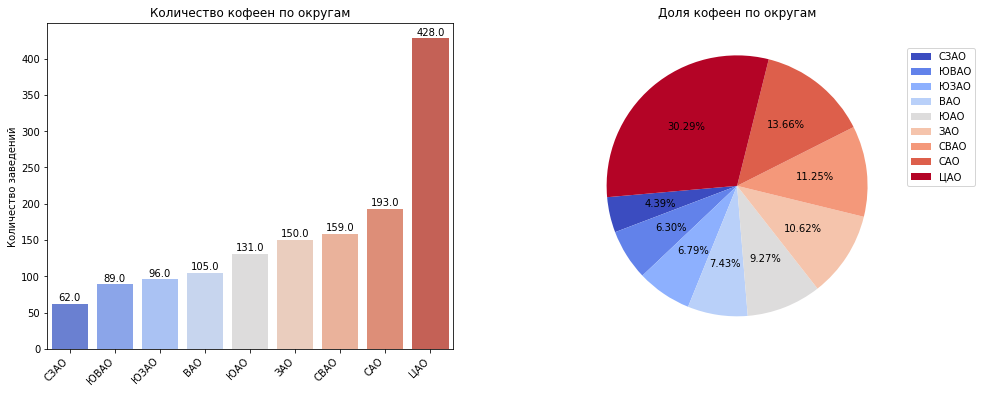

In [87]:
# Построим графики распределения кофеен по округам, а также их доли в общей выборке
fig= plt.figure(figsize=(16,6))
ax1=fig.add_subplot(1,2,1)
ax1=sns.barplot(x=coffee_spread.index, y='amount', data=coffee_spread, palette='coolwarm')
for bar in ax1.patches:
           ax1.annotate(format(bar.get_height()),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=10, xytext=(0, 6),
                  textcoords='offset points')
ax2=fig.add_subplot(1,2,2)
ax2=coffee_spread['amount'].plot(kind='pie', labels=None, label='', autopct='%.2f%%', \
                       legend=True, title='Доля кофеен по округам',\
                                 cmap='coolwarm', startangle=185, ax=ax2)
ax1.set_xticklabels(coffee_spread.index, rotation=45, ha='right')
ax1.set_xlabel('')
ax1.set_ylabel('Количество заведений')
ax1.set_title('Количество кофеен по округам')
ax2.legend(coffee_spread.index,loc=(1.02, 0.5))
plt.show()

Более 30% кофеен расположены в ЦАО, примерно такой же процент приходится на три округа САО, СВАО, ЗАО. На долю других округов приходится меньше 10% от общего числа кофеен

Рассмотрим, как распределены сетевые и не сетевые кофейни по округам

In [88]:
# Рассмотрим распределение сетевых и несетевых кофеен по округам
coffee_chain=(places
               .query('category=="кофейня"')
               .groupby(['district_short', 'chain'])
               .agg(amount=('name','count')).reset_index())

In [89]:
# Построим график распределения сетевых и несетевых кофеен по округам
fig = px.bar(coffee_chain, 
             x='amount',
             y='district_short',
             color='chain',
             text='amount',
             color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределение сетевых и несетевых кофеен по округам',
                   yaxis_title='',
                 yaxis={'categoryorder':'total ascending'},
                 xaxis={'visible': False}, title_x=0.5)
fig.show()

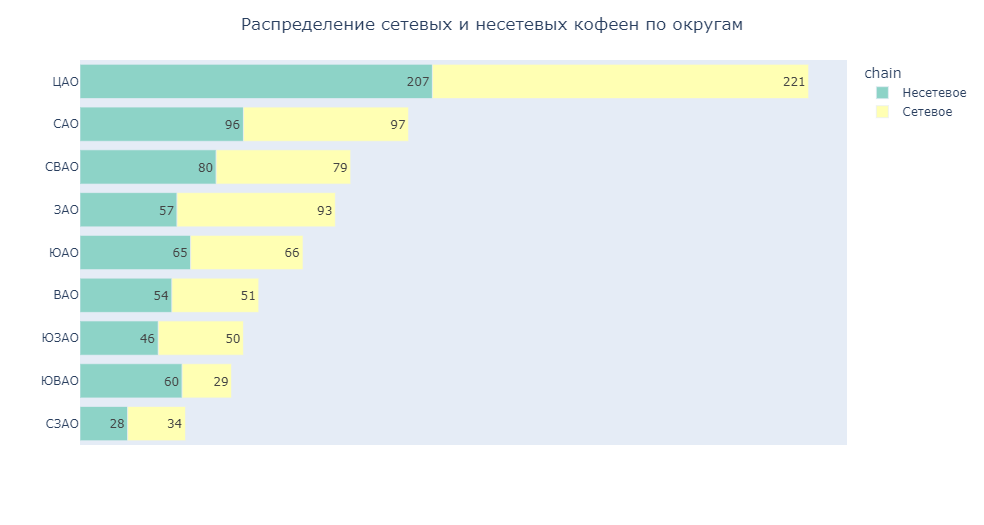

*Из распределения видим, что во всех округах, кроме ЗАО, доли сетевых и несетевых заведений равны. В ЗАО большую долю составляют сетевые заведения*

In [90]:
# Рассмотрим распределение среднего рейтинга между сетевыми и несетевыми кофейнями
coffee_rating=(places
               .query('category=="кофейня"')
               .groupby(['district_short', 'chain'])
               .agg(rating=('rating','mean'))
               .reset_index())

In [91]:
# Построим график распределения среднего рейтинга между сетевыми и несетевыми кофейнями
fig = px.line(coffee_rating, x='district_short', y='rating', color='chain', markers=True)
fig.update_layout(title='Средний рейтинг в зависимости от округа',
                   xaxis_title='Округ',
                   yaxis_title='Средний рейтинг', title_x=0.5)
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

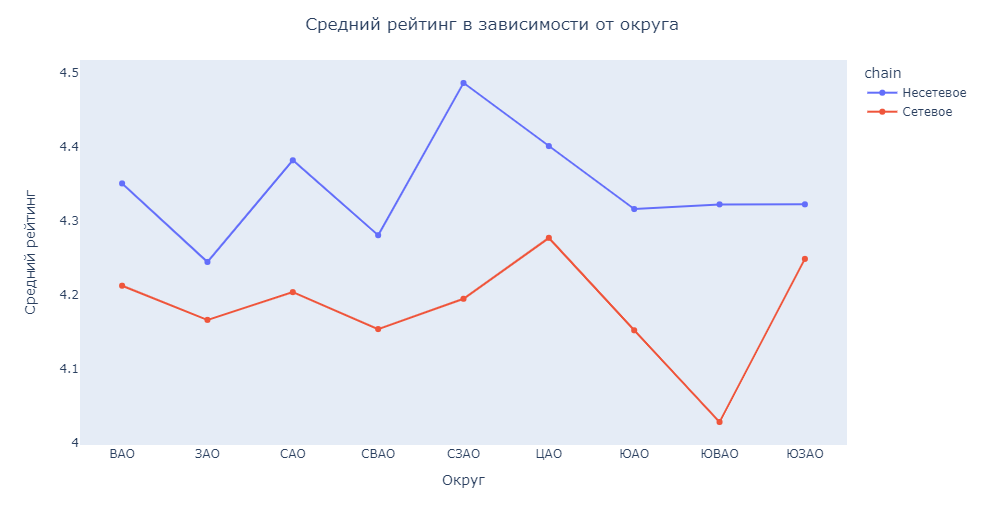

Из графика распределения рейтинга видим, что для сетевых заведений во всех округах характерен более низкий средний рейтинг, при этом наиболее низкий рейтинг в сетевых кофейнях ЮВАО. Среди несетевых кофеен наиболее низкий рейтинг имеют места в ЗАО, наиболее высокий в СЗАО  

In [92]:
# Рассмотрим, как расположены кофейни в разрезе улиц
# Особенностью данной категории является широкая представленность нескольких кофеен на одной улице
# Найдем 15 улиц, на которых расположено наибольшее количество кофеен
coffee_table=(places.query('category=="кофейня"')
              .groupby(['street', 'chain'])
              .agg(amount=('name','count'))
              .reset_index()
             .sort_values(by='amount', ascending=False).head(15))

In [93]:
# Построим график распрделения количества кофеен по топ-15 улицам
fig = px.bar(coffee_table, 
             x='amount',
             y='street',
             color='chain',
             text='amount',
             color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределение сетевых и несетевых кофеен по топ 15-улицам',
                   yaxis_title='',
                 yaxis={'categoryorder':'total ascending'},
                 xaxis={'visible': False}, title_x=0.5)
fig.show()

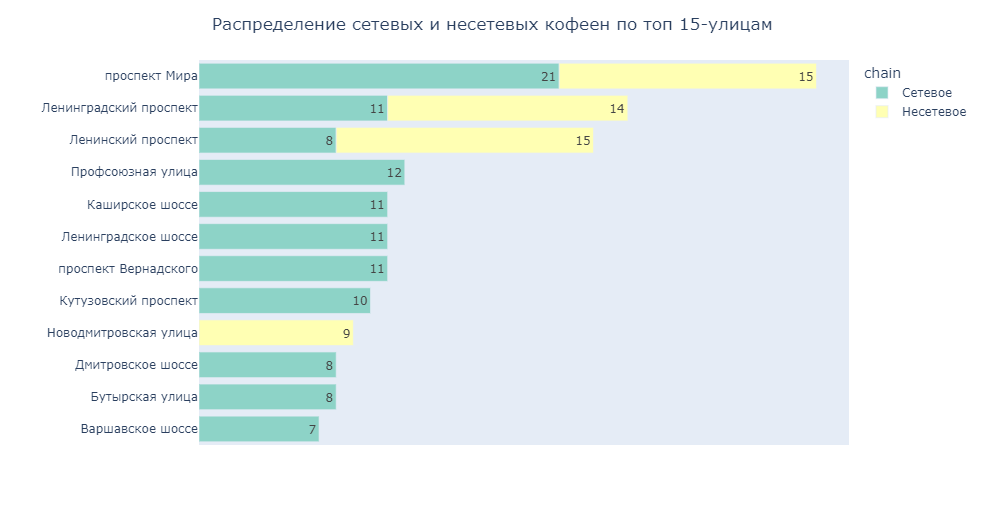

*Из распределения видим, что наибольшее количество кофеен расположено на Проспекте мира, ленинградском и ленинском проспектах. При этом практически на всех улицах, кроме ленинского и ленинградско проспекта, преобладают сетевые заведения*

In [94]:
# Найдем среднюю цену за чашку кофе в различных округах
coffee_price=(places
               .query('category=="кофейня"')
               .groupby(['district_short','chain'])
               .agg(price=('middle_coffee_cup','median')).reset_index())
# Построим распределение средней цены а чашку кофе в различных округах
fig = px.line(coffee_price, x='district_short', y='price', color='chain', markers=True)
fig.update_layout(title='Средняя цена чашки кофе в зависимости от округа',
                   xaxis_title='Округ',
                   yaxis_title='Средний чек', title_x=0.5)
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

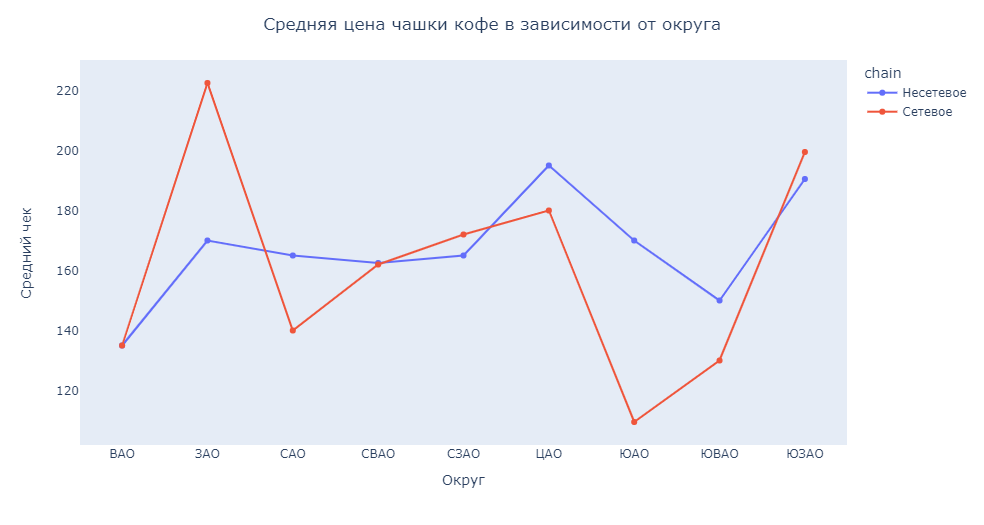

In [95]:
places.query('category=="кофейня" and middle_coffee_cup')


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7,district_short,rating_category,km,distance_category
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,Несетевое,NaN,улица Маршала Федоренко,True,САО,высокий (>4.5),16,15-20 км
72,лакрица,кофейня,"Москва, Алтуфьевское шоссе, 85",Северо-Восточный административный округ,"ежедневно, 08:00–21:00",55.891196,37.585653,4.5,средние,Цена чашки капучино:150–190 ₽,NaN,170.0,Несетевое,12.0,Алтуфьевское шоссе,True,СВАО,высокий (>4.5),15,15-20 км
81,coffee way,кофейня,"Москва, Алтуфьевское шоссе, 86, корп. 1",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.897789,37.588189,4.3,NaN,Цена чашки капучино:120–170 ₽,NaN,145.0,Сетевое,120.0,Алтуфьевское шоссе,True,СВАО,выше среднего (4.2-4.5),16,15-20 км
89,сахарочек,кофейня,"Москва, Дмитровское шоссе, 107А, корп. 2",Северный административный округ,пн-пт 09:00–22:00; сб 10:00–22:00; вс 10:00–21:00,55.879256,37.538444,4.5,средние,Цена чашки капучино:100–200 ₽,NaN,150.0,Несетевое,120.0,Дмитровское шоссе,False,САО,высокий (>4.5),15,15-20 км
100,take and wake,кофейня,"Москва, Дмитровское шоссе, 100, стр. 2",Северный административный округ,пн-пт 08:30–18:30,55.882019,37.546174,4.5,низкие,Цена чашки капучино:150–210 ₽,NaN,180.0,Сетевое,120.0,Дмитровское шоссе,False,САО,высокий (>4.5),15,15-20 км
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8332,baer coffee,кофейня,"Москва, Окская улица, 1, корп. 1",Юго-Восточный административный округ,пн 00:00–21:00; вт-сб 09:00–21:00; вс 00:00–21:00,55.711757,37.751269,4.4,низкие,Цена чашки капучино:120–180 ₽,NaN,150.0,Несетевое,80.0,Окская улица,False,ЮВАО,выше среднего (4.2-4.5),9,3-10 км
8339,coffee week,кофейня,"Москва, Рязанский проспект, 30, корп. 2",Юго-Восточный административный округ,"пн-пт 08:30–21:30; сб,вс 09:00–21:30",55.718199,37.784447,4.3,NaN,Цена чашки капучино:120–220 ₽,NaN,170.0,Несетевое,116.0,Рязанский проспект,False,ЮВАО,выше среднего (4.2-4.5),11,10-15 км
8345,bonjour,кофейня,"Москва, Шоссейная улица, 8",Юго-Восточный административный округ,"пн-пт 07:30–21:00; сб,вс 08:00–21:00",55.689958,37.725969,4.7,средние,Цена чашки капучино:130–190 ₽,NaN,160.0,Несетевое,NaN,Шоссейная улица,False,ЮВАО,высокий (>4.5),9,3-10 км
8362,квадрат кофе,кофейня,"Москва, Волгоградский проспект, 73, стр. 1",Юго-Восточный административный округ,"пн-пт 08:30–21:30; сб,вс 09:00–21:30",55.709710,37.744450,4.2,NaN,Цена чашки капучино:100–220 ₽,NaN,160.0,Несетевое,206.0,Волгоградский проспект,False,ЮВАО,выше среднего (4.2-4.5),9,3-10 км


*На графике видим, что разница между средними чеками в сетевых и несетевыми кофейнями варьируется от района к району, более высокий средний чек для сетевыъ заведений характерен для ЗАО, ЮЗАО, СЗАО. При этом наиболее высокий средний чек в несетевых кофейнях характерен для ЦАО, низкий для ВАО. Среди сетевых заведений наиболее высокий чек у ЗАО, низкий в ЮАО. При анализе стоит учесть, что информация по цене кофе была доступна только для 50% кофеен*

In [96]:
# Рассмотрим, как распределены сетевые заведения по районам
coffee_chain=(places
               .query('category=="кофейня" and chain=="Сетевое"')
              .groupby(['name', 'district_short'])
              .agg(amount=('name','count'), price=('middle_coffee_cup', 'median'))
              .reset_index()
              .sort_values(by='amount', ascending=False))

In [97]:
# Построим график распределения количества сетевых кофеен по районам
fig = px.bar(coffee_chain.query('amount>3'), #Оставим кофейни, количество которых больше 3
             x='amount',
             y='district_short',
             color='name',
             text='price',
             color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределение сетевых кофеен по округам',
                   yaxis_title='',
                 yaxis={'categoryorder':'total ascending'},
                 xaxis_title='Количество кофеен', title_x=0.5, font=dict(size=10))
fig.update_traces(textposition='inside', textfont_size=8)
fig.show()


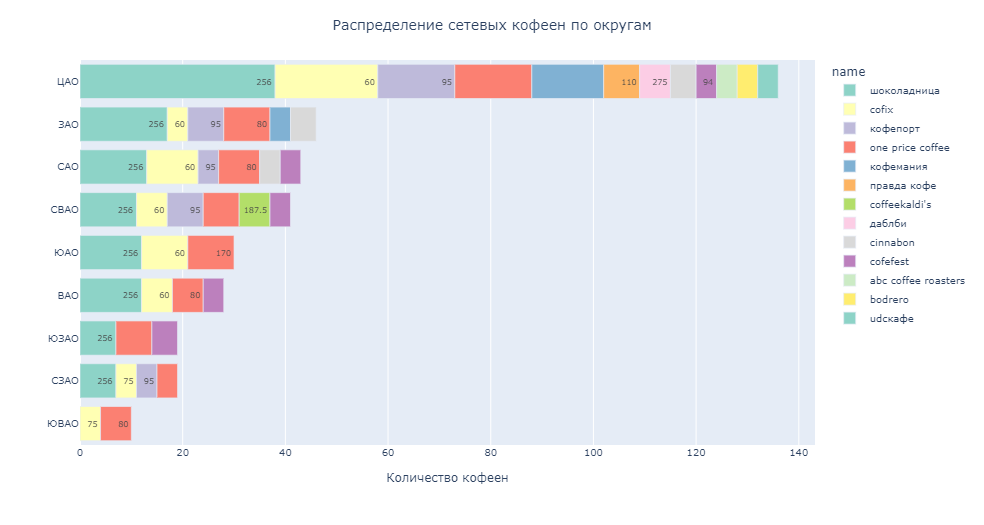

*Наиболее популярной сетевой кофейней является Шоколадница, в ней же установлен наиболее высокий средний чек 256 рублей, следом идут кофейни низкоценового сегмента, которые также широко распространены, при этом с ними будет тяжело конкурировать в цене*

In [98]:
# Для оценки доли каждой сети кофейни построим гистограмму распределения долей 
fig = px.histogram(coffee_chain.query('amount>3'), 
             x='amount',
             y='district_short',
             color='name',
             barnorm = "percent",
            color_discrete_sequence=px.colors.qualitative.Set3
                   
            )
fig.update_layout(title='Доли сетевых кофеен по округам',
                   yaxis_title='',
                 yaxis={'categoryorder':'total ascending'},
                 xaxis_title='Количество кофеен', title_x=0.5)

fig.show()

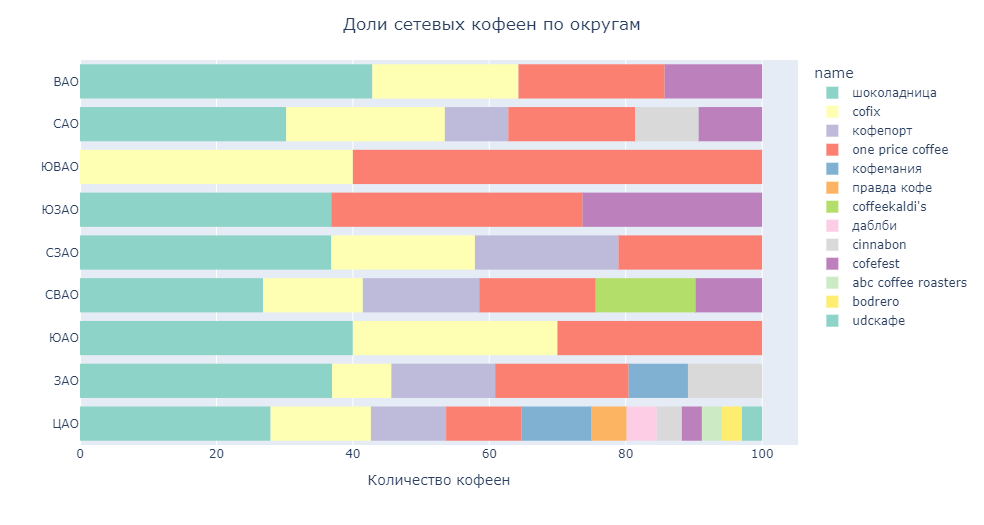

*Во всех округах доля низкоценовых кофеен высокая, при этом в ЗАО высокую долю составляют кофейни с более высоким средним чеком, также высокая доля шоколадниц в ЮЗАО и ЮАО, при этом всего два вида альтернативных сетевых кофеен* 

In [99]:
# Найдем круглосуточные кофейни
coffee_24=(places
           .query('category=="кофейня" and is_24_7')
           .groupby(['district_short', 'name'])
           .agg(amount=('name', 'count'))
           .reset_index()
          )

In [100]:
# Построим распределение круглосуточных кофеен по округам
fig = px.bar(coffee_24, 
             x='amount',
             y='district_short',
             color='name',
             color_discrete_sequence=px.colors.qualitative.Set3
            )
fig.update_layout(title='Распределение круглосуточных кофеен по округам',
                   yaxis_title='',
                 yaxis={'categoryorder':'total ascending'},
                 xaxis_title='Количество кофеен', title_x=0.5)
fig.show()

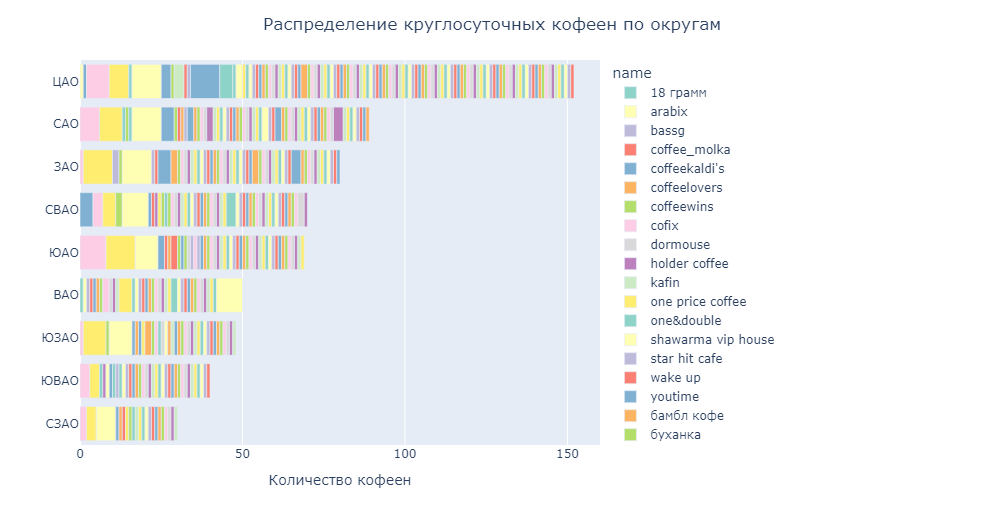

*Наибольшее количество круглосуточных кофеен в сети Шоколадница, также в ЦАО широко представлены круглосуточные Кофемании. Большинство круглосуточных кафе расположены в ЦАО, следом идут ЗАЮ и ЮЗАО, наименьшее количество в ЮАО и ЮВАО. При этом как было установлено ранее, круглосуточность работы не влияет на средний чек*   

**В результате анализа кофеен было установлено следующее:**

- Более 30% кофеен расположены в ЦАО, примерно такой же процент приходится на три округа САО, СВАО, ЗАО. На долю других округов приходится меньше 10% от общего числа кофеен
- Из распределения видим, что во всех округах, кроме ЗАО, доли сетевых и несетевых заведений равны. В ЗАО большую долю составляют сетевые заведения
- Особенностью данной категории является широкая представленность нескольких кофеен на одной улице. Наибольшее количество кофеен расположено на Проспекте мира, ленинградском и ленинском проспектах. При этом практически на всех улицах, кроме ленинского и ленинградско проспекта, преобладают сетевые заведения
- Среди сетевых заведений наиболее высокий чек у ЗАО, низкий в ЮАО. Средний чек в несетевых заведений варьируется от 135 до 195 рублей, в сетевых - от 135 до 222 рублей. При этом нужно учесть, что информация о цене была доступна только для 50% кофеен.
- Наиболее популярной сетевой кофейней является Шоколадница, в ней же установлен наиболее высокий средний чек, следом идут кофейни низкоценового сегмента, которые также широко распространены, при этом с ними будет тяжело конкурировать в цене
- Во всех округах доля низкоценовых кофеен высокая, при этом в ЗАО высокую долю составляют кофейни с более высоким средним чеком, также высокая доля шоколадниц в ЮЗАО, при этом всего два вида альтернативных сетевых кофеен

**Вывод по анализу кофеен:**

*При открытии кофейни необходимо учитывать высокую долю сетевых заведений с низкой ценой за чашку кофе, по цене необходимо ориентироваться на средний чек в отдельном районе. Так как в ЗАО, СЗАО и ЮЗАО цена сетевых кофеен выше, в данном районе будет легче конкурировать по цене с сетевыми заведениями. При этом в ЗАО также невысокий рейтинг несетевых заведений*

Общий вывод исследования:

- Рынок Москвы насыщен заведениями в категориях рестораны, кафе и кофейни
- Отмечается недостаток качественных мест в категориях кафе и места быстрого питания
- Рестораны и бары имеют наиболее высокий средний чек, при этом его уровень сильно зависит от рейтинга заведения
- В ЦАО представлено очень высокое количество мест общепита, при этом отмечается невысокая доля пиццерий
- Отмечены высокие значения среднего чека в ЗАО и САО, что позволит открыть более высокоценовое заведение в этих округах
- Отмечены низкие рейтинги ресторанов в ЮВАО и ВАО, и кофеен в ЗАО, учитывая высокий средний чек данной категории заведений, открытие качественного места позволит выделиться на фоне конкурентов
- Во всех округах отмечается высокая доля низкоценовых кофеен, при этом в ЗАО, ЮЗАО, СЗАО средняя цена за чашку кофе в сетевых заведениях выше, чем в несетевых

Рекомендации для дальнейшего исследования:

- Рассмотреть спрос на пиццерии в ЦАО
- Рассмотреть спрос на заведения общепита в САО и ЗАО
- Изучить спрос на бары в различных округах, проанализировать причины высоких рейтингов
- Оценить спрос на кофейни в ЗАО


### Презентация

Ссылка на презентацию: https://drive.google.com/file/d/1eFloCvbWJIIEi3t8BkBxFilkByKjS_gm/view?usp=sharing